# **MIE 1517 Project: Facial Recognition of Celebrities (Avengers cast)**

**Zijie Zhao**

**Yunqing Tang**

**Chin Ming Wong**

**Peng Yang**

Colab Link: https://drive.google.com/file/d/1n9nFeK_VoV1K7aYEP7dWDcOBmnlZ0Pc4/view?usp=sharing

# Project Overview & Related Works

***Overview***

Have you ever seen a photo of a person who looks extremely familiar, and the name is on the tip of your tongue, but you just can't quite get it? Well, if you're bad with names like me, this happens frequently especially for celebrities. That's why we thought it would be useful to develop a model that can tell you the name. To make the project more feasible, we decided to limit the pool of celebrities to our 10 favourite cast members in the Marvel Avengers series.

The idea is to take an image of a face and run it through a model that will tell you if the person is actually part of the Avengers cast. If so, then a second model will give the name of the Avengers celebrity. The overall pipeline is shown in the figure below:

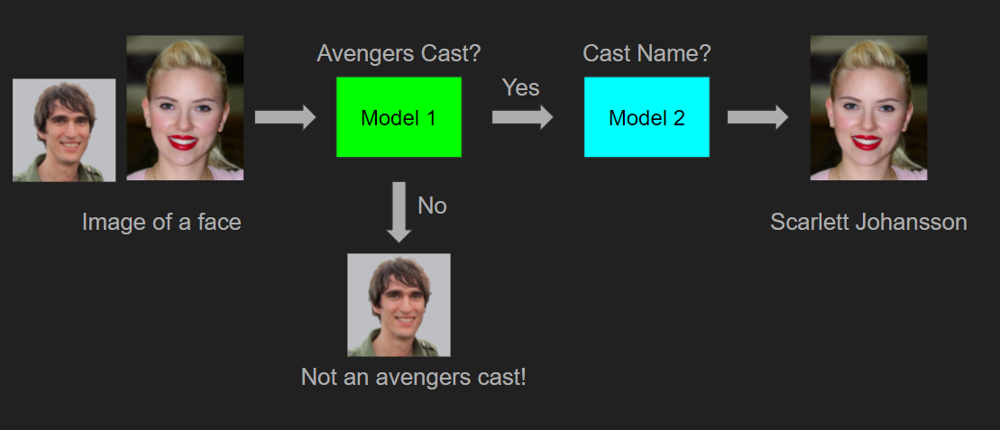



There are two models to train in this pipeline, so we will work on each one separately. However, we will preprocess the data used for both models all at once. The models will leverage transfer learning by using pretrained models in PyTorch, but the fully-connected classifiers will be handwritten and trained on the output features of the pretrained models. Afterwards, both models are combined with some preprocessing steps to create the entire pipeline.

***Related Works***

Facial recognition is an area that is well studied with implementations in multiple fields from security systems to camera filters on social media applications. As a result, celebrity facial recognition, like normal facial recognition, has already been explored. In comparison to the work already done, our project is very basic and elementary. Nevertheless, it was still worthwhile to explore the area and to gain an insight and appreciation on the potential of deep learning in facial recognition.

In somewhat recent times, Google has implemented Google Lens, an image recognition technology, and even more recently, it was deployed on Google Images. It can recognize all kinds of objects including celebrity faces, and a quick search of any celebrity and using Google Lens on the image results will give the name and some short background information. It seemed really accurate when we tested it.

Celebrity look-alikes is a fun area of facial recognition, and some companies such as clarifai [1] has already capitalized on it (for profit). The small demonstration on its website seems to be quite accurate with the ability to detect and to classify many faces in one image at varying face sizes.

Much like us, many deep learning enthusiasts have played around with celebrity facial recognition such as [2][3]. Although performance metrics weren't calculated, some of the qualitative examples that they presented showed very good results.

Some people even wrote and published research papers (recent) on this area. In [4], the authors even used some of the same data set as us. However, if one were to read the contents of the paper, they achieved very high accuracy, but it is uncertain how they accomplished the task of predicting celebrity name given that the data set is unlabelled. Nevertheless, this clearly demonstrates that many people have done similar works at a professional (complex) and an amateur (simple) level.

[1] https://www.clarifai.com/models/celebrity-face-recognition

[2] https://towardsdatascience.com/which-celebrity-are-you-d8c6507f21c9

[3] https://medium.com/@gurpreets0610/celebrity-face-recognition-521c2f9bba9

[4] https://www.researchgate.net/publication/327249814_Celebrity_Face_Recognition_using_Deep_Learning









# Part 0: Notebook Setup


We will first import some necessary libraries. Other libraries will be imported as needed.

In [ ]:
# Import libraries
import os
import numpy as np
import torch
import shutil
import PIL
from PIL import Image
import matplotlib.pyplot as plt
from cv2 import cv2

import torchvision
from torchvision import datasets, models, transforms
os.environ['CUDA_LAUNCH_BLOCKING'] = '1' 

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim 

torch.manual_seed(1) # Set the random seed

Since we are using Google Colab, we will mount Google Drive to access various files.

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Google Colab provides (limited) access to a GPU, so we will leverage it to speed up computation.

In [ ]:
# GPU
use_cuda = True
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('Running on device: {}'.format(device))

Running on device: cuda:0


# Part 1: Data Exploration & Preprocessing

## Data Exploration

We will first take a look at what some of the raw data look like.

In [ ]:
# Data loading
data_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module 2/'
data_transform = transforms.Compose([transforms.ToTensor()])
raw_data = datasets.ImageFolder(data_dir, transform = data_transform)

A single image of Robert Downey Jr. is shown below. 

302 320 RGB JPEG <class 'PIL.JpegImagePlugin.JpegImageFile'>


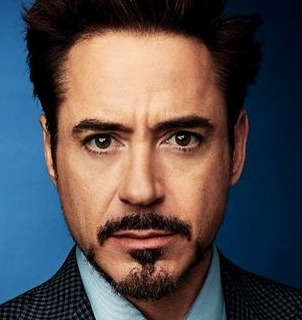

In [ ]:
# Display a sample image
im = PIL.Image.open(data_dir + '/Robert Downey Jr/Robert Downey Jr8_4304.jpg')
print(im.width, im.height, im.mode, im.format, type(im))
display(im)

More images of the Avengers cast are shown below.

In our raw dataset, we have some examples that are not square images, and some other examples that are not oriented properly. We will fix these problems in the **Data Preprocessing** section below. 

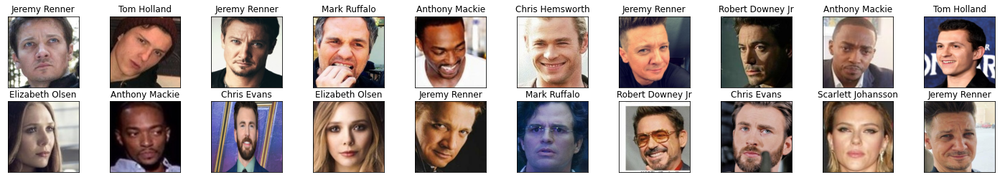

In [ ]:
# Visualize some of the Avengers cast 
classes = ['Anthony Mackie', 'Chris Evans', 'Chris Hemsworth', 
           'Elizabeth Olsen', 'Jeremy Renner', 'Mark Ruffalo', 
           'Robert Downey Jr', 'Scarlett Johansson', 'Tom Hiddleston',
           'Tom Holland']
data_loader = torch.utils.data.DataLoader(raw_data, batch_size = 20, shuffle = True)

# Obtain one batch of training images
dataiter = iter(data_loader)
images, labels = dataiter.next()
images = images.numpy() # Convert images to numpy for display

# Plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize = (25, 4))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx + 1, xticks = [], yticks = [])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title(classes[labels[idx]])

## Data Preprocessing

Since we just want the face and nothing else, we will crop them out, modify their orientations by detecting eye positions, and save them. To do this, the Deepface library is used to detect and to crop faces. This library uses various state-of-the-art models such as Facebook DeepFace and Google FaceNet. We will use the Facebook DeepFace. More information can be found here: https://github.com/serengil/deepface

In [ ]:
# Import libraries for face cropping
pip install deepface
pip name_fuinction

from deepface import DeepFace
import unittest
import random

### Model 1 Data Preprocessing

We will preprocess and split the data for model 1 by cropping the faces and saving them in new directories and folders.

First of all, we set the raw data directories and the target directories for our processed data. For our training and validation datasets, we used the data from **Pins Face Recognition Dataset** [5] and **CelebFaces Attributes (CelebA) Dataset** [6] from Kaggle. For our test dataset, we gathered some new, never before seen data from Google Images and cropped images from videos. Our training and validation images are in one folder, and our test images are in another folder. 

For Model 1, we will process these two folders seperately.

[5] https://www.kaggle.com/hereisburak/pins-face-recognition \\
[6] https://www.kaggle.com/jessicali9530/celeba-dataset

In [ ]:
# Set up data directory
m1_data_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module 1/' # Directory of raw main data
m1_test_data_dir = '/content/drive/My Drive/MIE1517 Project/Test Data/Module 1/' # Directory of raw test data

m1_fc_data_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Face Crop Module1/' # New directory for cropped main data
m1_fc_test_data_dir = '/content/drive/My Drive/MIE1517 Project/Test Data/M1_Face_Cropped_Test/' # New directory for cropped test data

m1_fc_data_split_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Face Crop Module1 Data Split/' # New directory for main data split

# Classes for model 1
m1_cls = ['Non-Avengers', 'Avengers']

**For the training and validation datasets**: we first cropped the faces out from the images, adjusted the faces' orientations according to the detected eyes positions, and then saved them in the target training and validation directory.

In [ ]:
# Crop the faces for main data
for n in range (2): # 2 classes
  image_list = []
  m1_cls_dir = os.path.join(m1_data_dir, m1_cls[n])

  # Make folder if it does not exist
  if os.path.isdir(m1_fc_data_dir + m1_cls[n]) is False:
      os.makedirs(m1_fc_data_dir + m1_cls[n])

  # Get the file names
  for filename in os.listdir(m1_cls_dir):
    image_list.append(filename)

  # Load the images
  for i in image_list:
    img_dir = os.path.join(m1_cls_dir, i)
    img = cv2.imread(img_dir)

  # Detect faces and write to file
    try:
      detected_face = DeepFace.detectFace(img)
      detected_face = detected_face * 255
      cv2.imwrite(m1_fc_data_dir + m1_cls[n] + '/' + i, detected_face[:, :, ::-1])
    except ValueError:
      pass    

After saving the processed images, we splitted the training and validation dataset into two folders with at a ratio of 80-20.

It is worth noting that we have 1594 images in total for the Avengers cast, and 5593 images for the other people. This is because our total number of images is limited by our computation capacity, and there are many more features to learn for our random, non-Avengers images than for our Avengers images. Therefore, to make our model more accurately capture these features with limited capacity, we chose to use more images for our non-Avengers class. We will keep the same number of images for the two classes in our test dataset.

In [ ]:
# Split the train/val data set into 2 folders, namely train and val
for cls in m1_cls:
  class_dir = m1_fc_data_dir + cls # The folder to look for the images of each letter
  img_names = (os.listdir(class_dir)) # Get the file names of the images
  random.shuffle(img_names) # Shuffle the names

  # Check if there is a train and val folder and make one if not
  if os.path.isdir(m1_fc_data_split_dir + '/train/' + cls) is False:
    os.makedirs(m1_fc_data_split_dir + '/train/' + cls)

  if os.path.isdir(m1_fc_data_split_dir + '/val/' + cls) is False:
    os.makedirs(m1_fc_data_split_dir + '/val/' + cls)

  # Splitting the data
  train_ratio = 0.8
  train, val = np.split(img_names, [int(len(img_names)*train_ratio)])

  # Get the file names and split into each set
  train_names = [class_dir + '/' + name for name in train]
  val_names = [class_dir + '/' + name for name in val]

  print('For {}:'.format(cls))
  print('Total number of images: ', len(img_names))
  print('Total number of training images: ', len(train_names))
  print('Total number of validation images: ', len(val_names))
  print('\n')

  # Copy the images to the new folders
  for file_name in train_names:
    shutil.copy(file_name, m1_fc_data_split_dir + '/train/' + cls)
  for file_name in val_names:
    shutil.copy(file_name, m1_fc_data_split_dir + '/val/' + cls)

For Non-Avengers:
Total number of images:  5593
Total number of training images:  4474
Total number of validation images:  1119


For Avengers:
Total number of images:  1594
Total number of training images:  1275
Total number of validation images:  319




**For the test dataset**: we first cropped the faces out from the images, adjusted the faces' orientations according to the detected eyes positions, and then saved them in the target test directory.



In [ ]:
# Crop the faces for test data
for n in range (2): # 2 classes
  image_list = []
  m1_cls_dir = os.path.join(m1_test_data_dir, m1_cls[n])

  # Make folder if it does not exist
  if os.path.isdir(m1_fc_test_data_dir + m1_cls[n]) is False:
      os.makedirs(m1_fc_test_data_dir + m1_cls[n])
      
  # Get the file names
  for filename in os.listdir(m1_cls_dir):
    image_list.append(filename)

  # Load the images
  for i in image_list:
    img_dir = os.path.join(m1_cls_dir, i)
    img = cv2.imread(img_dir)

  # Detect faces and write to file
    try:
      detected_face = DeepFace.detectFace(img)
      detected_face = detected_face * 255
      cv2.imwrite(m1_fc_test_data_dir + m1_cls[n] + '/' + i, detected_face[:, :, ::-1])
    except ValueError:
      pass    

### Model 2 Data Preprocessing

We will preprocess and split the data for Model 2 by cropping the faces and saving them in new directories and folders. The processing procedure for Model 2 is very similar to the one for Model 1. 

The only two differences are: (1) for our training and validation data, we only used the images from **Pins Face Recognition Dataset**, and (2) we used a balanced dataset for our ten Avengers cast members.

In [ ]:
# Set up data directory
m2_data_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module 2/' # Directory of raw main data
m2_test_data_dir = '/content/drive/My Drive/MIE1517 Project/Test Data/Module 2/' # Directory of raw test data

m2_fc_data_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Face Crop Module2/' # New directory for cropped main data
m2_fc_test_data_dir = '/content/drive/My Drive/MIE1517 Project/Test Data/M2_Face_Cropped_Test/' # New directory for cropped test data
m2_fc_data_split_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Face Crop Module2 Data Split/' # New directory for main data split

# Classes for model 2
m2_cls = ['Anthony Mackie/', 'Chris Evans/', 'Chris Hemsworth/', 'Elizabeth Olsen/', 'Jeremy Renner/', 
          'Mark Ruffalo/', 'Robert Downey Jr/', 'Scarlett Johansson/', 'Tom Hiddleston/', 'Tom Holland/']

In [ ]:
# Crop the faces for main data
for n in range (10): # 2 classes
  image_list = []
  m2_cls_dir = os.path.join(m2_data_dir, m2_cls[n])

  # Make folder if it does not exist
  if os.path.isdir(m2_fc_data_dir + m2_cls[n]) is False:
      os.makedirs(m2_fc_data_dir + m2_cls[n])

  # Get the file names
  for filename in os.listdir(m2_cls_dir):
    image_list.append(filename)

  # Load the images
  for i in image_list:
    img_dir = os.path.join(m2_cls_dir, i)
    img = cv2.imread(img_dir)

  # Detect faces and write to file   
    try:
      detected_face = DeepFace.detectFace(img)
      detected_face = detected_face * 255
      cv2.imwrite(m2_fc_data_dir + m2_cls[n]+ i, detected_face[:, :, ::-1])
    except ValueError:
      pass    

In [ ]:
# Split train/val data set into 2 folders, namely train and val
for cls in m2_cls:
  class_dir = m2_fc_data_dir + cls # The folder to look for the images of each class
  img_names = os.listdir(class_dir) # Get the file names of the images
  random.shuffle(img_names) # Shuffle the file names

  # Check if there is a train and val folder and make one if not
  if os.path.isdir(m2_fc_data_split_dir + '/train//' + cls) is False:
    os.makedirs(m2_fc_data_split_dir + '/train//' + cls)

  if os.path.isdir(m2_fc_data_split_dir + '/val//' + cls) is False:
    os.makedirs(m2_fc_data_split_dir + '/val//' + cls)

  # Splitting the data
  train_ratio = 0.8
  train, val = np.split(img_names, [int(len(img_names)*train_ratio)])

  # Get the file names and split into each set
  train_names = [class_dir + '/' + name for name in train]
  val_names = [class_dir + '/' + name for name in val]

  print('For {}:'.format(cls))
  print('Total number of images: ', len(img_names))
  print('Total number of training images: ', len(train_names))
  print('Total number of validation images: ', len(val_names))
  print('\n')

  # Copy the images to the new folders
  for file_name in train_names:
    shutil.copy(file_name, m2_fc_data_split_dir + '/train//' + cls)
  for file_name in val_names:
    shutil.copy(file_name, m2_fc_data_split_dir + '/val//' + cls)

For Anthony Mackie/:
Total number of images:  131
Total number of training images:  104
Total number of validation images:  27


For Chris Evans/:
Total number of images:  169
Total number of training images:  135
Total number of validation images:  34


For Chris Hemsworth/:
Total number of images:  181
Total number of training images:  144
Total number of validation images:  37


For Elizabeth Olsen/:
Total number of images:  190
Total number of training images:  152
Total number of validation images:  38


For Jeremy Renner/:
Total number of images:  189
Total number of training images:  151
Total number of validation images:  38


For Mark Ruffalo/:
Total number of images:  186
Total number of training images:  148
Total number of validation images:  38


For Robert Downey Jr/:
Total number of images:  168
Total number of training images:  134
Total number of validation images:  34


For Scarlett Johansson/:
Total number of images:  169
Total number of training images:  135
Total n

In [ ]:
# Crop the faces for test data
for n in range (10): # 2 classes
  image_list = []
  m2_cls_dir = os.path.join(m2_test_data_dir, m2_cls[n])

  # Make folder if it does not exist
  if os.path.isdir(m2_fc_test_data_dir + m2_cls[n]) is False:
      os.makedirs(m2_fc_test_data_dir + m2_cls[n])

  # Get the file names
  for filename in os.listdir(m2_cls_dir):
    image_list.append(filename)

  # Load the images
  for i in image_list:
    img_dir = os.path.join(m2_cls_dir, i)
    img = cv2.imread(img_dir)

  # Detect faces and write to file
    try:
      detected_face = DeepFace.detectFace(img)
      detected_face = detected_face * 255
      cv2.imwrite(m2_fc_test_data_dir + m2_cls[n]+ i, detected_face[:, :, ::-1])
    except ValueError:
      pass    

# Part 2: Model 1 - Avengers Cast vs. Non-Avengers 

For the first model, it will distinguish faces of the Avengers cast from other people. The preprocessed data will be loaded and resized to a size of 224 $\times$ 224 pixels, which is required for a pre-trained VGG16 network.

In [ ]:
# Data loading & transformation

# Set up data directory
data_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Face Crop Module1 Data Split/'
train_dir = os.path.join(data_dir, 'train/')
val_dir = os.path.join(data_dir, 'val/')

# Ensure all images are 224 x 224 by resizing them
data_transform = transforms.Compose([transforms.Resize((224, 224)), 
                                      transforms.ToTensor()])

train_data = datasets.ImageFolder(train_dir, transform = data_transform)
val_data = datasets.ImageFolder(val_dir, transform = data_transform)

# Check number of images
print('Number of training images: ', len(train_data))
print('Number of validation images: ', len(val_data))

Number of training images:  5749
Number of validation images:  1438


The pretrained model that will be used for transfer learning is VGG16. The images will be fed into VGG16 and then the output right before the fully-connected layers will be saved to file to prevent rerunning the code every time.

In [ ]:
# Load pretrained VGG16 model
vgg_net = torchvision.models.vgg16(pretrained = True)

# Directory to save the output features
vgg16_model1_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Model1_VGG16/'
if os.path.isdir(vgg16_model1_dir) is False:
      os.makedirs(vgg16_model1_dir)

In [ ]:
# Saving the output features 
def save_features(data,batch_size,data_name):
    n = 1
    for imgs, labels in torch.utils.data.DataLoader(data, batch_size = batch_size, shuffle = True):

        if use_cuda and torch.cuda.is_available(): # GPU
          imgs = imgs.cuda()
          labels = labels.cuda()

        features = vgg_net.features(imgs) # Only use the feature extraction portion of VGG16

        # Setting the directory paths
        data_path = vgg16_model1_dir + get_data_name(data_name, batch_size, n)
        label_path = vgg16_model1_dir + "label_" + get_data_name(data_name, batch_size, n)
        original_data_path = vgg16_model1_dir + get_data_name(data_name, batch_size, n) + "original_data"

        # Save the features
        torch.save(features, data_path)
        torch.save(labels, label_path)
        torch.save(imgs, original_data_path)
        n+=1

def get_data_name(name, batch_size, n):
    """ Generate a name for the data with batch size
    """
    path = "vgg_16_data_{0}_bs{1}_{2}.pt".format(name, batch_size, n)
    return path

Due to the GPU capacity, a batch size of 32 was selected. This batch size worked well in the following model training process.

In [ ]:
save_features(train_data, 32, "train")

In [ ]:
save_features(val_data, 32, "val")

In [ ]:
save_features(test_data, 32, "test")

A custom classifier is written and trained on the output features from the VGG16 feature extractor. There is a lot of flexibility here, but we decided to keep it simple due to computation limitations. The training function is also written along with the accuracy function.

In [ ]:
class VGG16Classifier(nn.Module):
    def __init__(self):
        super(VGG16Classifier, self).__init__()
        self.conv1 = nn.Conv2d(512, 50, 2)
        self.conv2 = nn.Conv2d(50, 10, 2)
        self.fc1 = nn.Linear(250, 50)
        self.fc2 = nn.Linear(50, 2)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = x.view(-1, 250)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x

In [ ]:
# Accuracy function
def get_accuracy(model, data_loader, batch_size, train = False, val = False, test = False):
    correct = 0
    total = 0
    k = 1 

    # Load saved feature data and labels
    for imgs, labels in data_loader:
        if train:
          file_name = vgg16_model1_dir + get_data_name("train", batch_size, k)
          label_name = vgg16_model1_dir + "label_" + get_data_name("train", batch_size, k)
        if val:
          file_name = vgg16_model1_dir + get_data_name("val", batch_size, k)
          label_name = vgg16_model1_dir + "label_" + get_data_name("val", batch_size, k)
        if test:
          file_name = vgg16_model1_dir + get_data_name("test", batch_size, k)
          label_name = vgg16_model1_dir + "label_" + get_data_name("test", batch_size, k)

        k += 1
        imgs = torch.load(file_name)
        labels = torch.load(label_name)

        #############################################
        # To Enable GPU Usage
        if use_cuda and torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
        #############################################
        
        output = model(imgs)
        pred = output.max(1, keepdim = True)[1] # Select index with maximum prediction score
        correct += pred.eq(labels.view_as(pred)).sum().item()
        total += imgs.shape[0]

    return correct / total
  
# Training function
def train(model, data, batch_size, num_epochs, lr, printed = True, plotted = True):
    train_loader = torch.utils.data.DataLoader(data, batch_size=batch_size, 
                                           num_workers=0, shuffle=False)
    
    val_loader = torch.utils.data.DataLoader(val_data, batch_size=batch_size,
                                             num_workers=0, shuffle=False)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr = lr, momentum = 0.9)

    iters, losses, train_acc, val_acc = [], [], [], []

    # Training
    n = 0 # The number of iterations
    for epoch in range(num_epochs):
        k = 1
        print("Training Epoch "+ str(epoch + 1)) 

        for imgs, labels in iter(train_loader):

            # Load saved feature data and labels
            file_name = vgg16_model1_dir + get_data_name("train", batch_size, k)
            label_name = vgg16_model1_dir + "label_" + get_data_name("train", batch_size, k)

            k += 1
            imgs = torch.load(file_name)
            labels = torch.load(label_name)

            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              imgs = imgs.cuda()
              labels = labels.cuda()
            #############################################

            out = model(imgs)             # Forward pass
            loss = criterion(out, labels) # Compute the total loss
            loss.backward()               # Backward pass (compute parameter updates)
            optimizer.step()              # Make the updates for each parameter
            optimizer.zero_grad()         # Clean up step for PyTorch

            # Save the current training information
            iters.append(n)
            losses.append(float(loss)/batch_size) # Compute *average* loss

            training_accuracy = get_accuracy(model, train_loader,batch_size,train=True)
            train_acc.append(training_accuracy) # Compute training accuracy 

            validation_accuracy = get_accuracy(model, val_loader,batch_size,val=True)
            val_acc.append(validation_accuracy)  # Compute validation accuracy

            # Print the training information
            if printed:
              print("Iteration " + str(n) + ":")
              print("CE Loss:" + str(float(loss) / batch_size))
              print("Training Accuracy = " + str(training_accuracy))
              print("Validation Accuracy = " + str(validation_accuracy))
            n += 1

    # Save the model
    model_path = "vgg16model_bs{0}_lr{1}_epoch{2}".format(batch_size,
                                                   lr,
                                                   num_epochs)
    model_path = vgg16_model1_dir + model_path
    torch.save(model.state_dict(), model_path)

    # Print learning curves
    if plotted:
      plt.title("Training Curve")
      plt.plot(iters, losses, label = "Train")
      plt.xlabel("Iterations")
      plt.ylabel("Loss")
      plt.show()

      plt.title("Training Curve")
      plt.plot(iters, train_acc, label = "Train")
      plt.plot(iters, val_acc, label = "Validation")
      plt.xlabel("Iterations")
      plt.ylabel("Training Accuracy")
      plt.legend(loc = 'best')
      plt.show()

    print("Final Training Accuracy: {}".format(train_acc[-1]))
    print("Final Validation Accuracy: {}".format(val_acc[-1]))

We found that the results are the best when the model is trained using the following parameters:

Batch Size = 32 \\
Number of Epoches = 5 \\
Learning Rate = 0.005

CUDA is available!  Training on GPU ...
Training Model:batch_size = 32, num_epochs = 5, lr = 0.005
Training Epoch 1
Training Epoch 2
Training Epoch 3
Training Epoch 4
Training Epoch 5


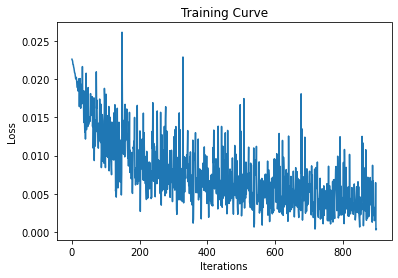

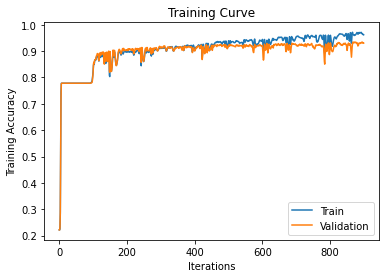

Final Training Accuracy: 0.9617324752130806
Final Validation Accuracy: 0.9304589707927677


In [ ]:
use_cuda = True

model_32_5_005 = VGG16Classifier()

if use_cuda and torch.cuda.is_available():
  model_32_5_005.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')
  
#proper model
print("Training Model:batch_size = 32, num_epochs = 5, lr = 0.005")
train(model_32_5_005, train_data, batch_size = 32, num_epochs = 5, lr = 0.005, printed = False)

Assuming the model has already been trained and saved, it can be loaded directly. The chosen model will be used on the test data.

In [ ]:
# Load the saved data
test_loader = torch.utils.data.DataLoader(test_data, batch_size = 32, num_workers = 0, shuffle = False)

# Load the chosen model
trained_model_path = "vgg16model_bs{0}_lr{1}_epoch{2}".format(32, 0.005, 5)
trained_model_path = vgg16_model1_dir + trained_model_path
trained_model = VGG16Classifier()

use_cuda = True
if use_cuda and torch.cuda.is_available():
  trained_model = trained_model.cuda()

trained_model.load_state_dict(torch.load(trained_model_path))

<All keys matched successfully>

A function that prints out our testing results for Model 1 is written below.

In [ ]:
# Printing the test results
def print_test_results(model, data_loader, batch_size):
    correct, total = 0, 0
    k = 1

    img_correct_avg, label_correct_avg = [], []
    img_correct_non_avg, label_correct_non_avg = [], []
    img_notcorrect_avg, label_notcorrect_avg = [], []
    img_notcorrect_non_avg, label_notcorrect_non_avg = [], []

    # Evaluating model on test data
    for imgs, labels in data_loader:
        file_name = vgg16_model1_dir + get_data_name("test", batch_size, k)
        label_name = vgg16_model1_dir + "label_" + get_data_name("test", batch_size, k)
        original_data_name = vgg16_model1_dir + get_data_name("test", batch_size, k) + "original_data"

        k += 1

        imgs = torch.load(file_name)
        labels = torch.load(label_name)
        original_imgs = torch.load(original_data_name)

        #############################################
        # To Enable GPU Usage
        if use_cuda and torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
          original_imgs = original_imgs.cuda()
        #############################################
        
        output = model(imgs)
        pred = output.max(1, keepdim=True)[1] # Select index with maximum prediction score
        correct += pred.eq(labels.view_as(pred)).sum().item()
        total += imgs.shape[0]

        # Get the accuracies for each class (A better alternative is a confusion matrix)
        for i in range(imgs.shape[0]):
          if pred.eq(labels.view_as(pred))[i][0]:
            if labels[i] == 0:
              img_correct_avg.append(original_imgs[i])
              label_correct_avg.append(0)
            else:
              img_correct_non_avg.append(original_imgs[i])
              label_correct_non_avg.append(1)
          else:
            if labels[i] == 0:
              img_notcorrect_avg.append(original_imgs[i])
              label_notcorrect_avg.append(0)
            else:
              img_notcorrect_non_avg.append(original_imgs[i])
              label_notcorrect_non_avg.append(1)

    print("The testing accuracy is: " + str(correct / total))
    print(" ")

    num_avg_correct = len(label_correct_avg)
    num_non_avg_correct = len(label_correct_non_avg)
    num_avg_notcorrect = len(label_notcorrect_avg)
    num_non_avg_notcorrect = len(label_notcorrect_non_avg)

    print(str(num_avg_correct) + " Avengers images were identified correctly.")
    print(str(num_avg_notcorrect) + " Avengers images were identified as non-Avengers images.")
    print(" ")
    print(str(num_non_avg_correct) + " non-Avengers images were identified correctly.")
    print(str(num_non_avg_notcorrect) + " non-Avengers images were identified as Avengers images.")
    
    return img_correct_avg, label_correct_avg, img_correct_non_avg, label_correct_non_avg, img_notcorrect_avg, label_notcorrect_avg, img_notcorrect_non_avg, label_notcorrect_non_avg

The quantitative and qualitative results on the test data are shown below. Discussions will be made towards the end of the notebook.

In [ ]:
img_correct_avg,label_correct_avg,img_correct_non_avg,label_correct_non_avg,img_notcorrect_avg,label_notcorrect_avg,img_notcorrect_non_avg,label_notcorrect_non_avg = print_test_results(trained_model, test_loader, 32)

The testing accuracy is: 0.8652575957727873
 
298 Avengers images were identified correctly.
79 Avengers images were identified as non-Avengers images.
 
1012 non-Avengers images were identified correctly.
125 non-Avengers images were identified as Avengers images.


Some examples of Avengers images that were identified correctly:


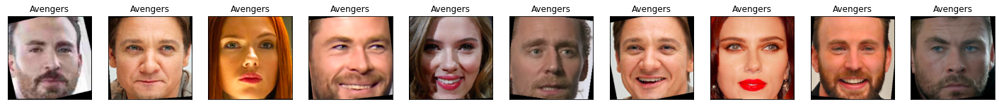

In [ ]:
# Visualize some correct test results
classes = ['Avengers', 'Non-Avengers']

print("Some examples of Avengers images that were identified correctly:")
    
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize = (25, 10))
for idx in range(10):
    ax = fig.add_subplot(1, 10, idx + 1, xticks = [], yticks = [])
    plt.imshow(np.transpose(img_correct_avg[idx].cpu().numpy(), (1, 2, 0)))
    ax.set_title(classes[label_correct_avg[idx]])

Some examples of Avengers images that were not identified correctly:


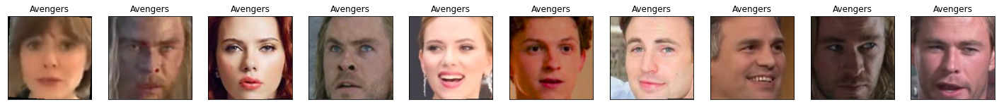

In [ ]:
# Visualize some incorrect test results
print("Some examples of Avengers images that were not identified correctly:")
    
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize = (25, 10))
for idx in range(10):
    ax = fig.add_subplot(1, 10, idx + 1, xticks = [], yticks = [])
    plt.imshow(np.transpose(img_notcorrect_avg[idx].cpu().numpy(), (1, 2, 0)))
    ax.set_title(classes[label_notcorrect_avg[idx]])

Some examples of non-Avengers images that were not identified correctly:


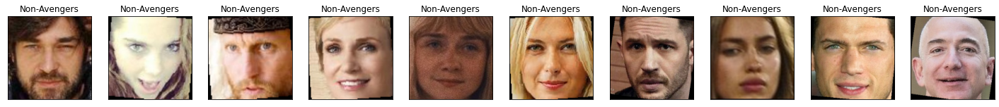

In [ ]:
# Visualize some incorrect test results
print("Some examples of non-Avengers images that were not identified correctly:")
    
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize = (25, 10))
for idx in range(10):
    ax = fig.add_subplot(1, 10, idx + 1, xticks = [], yticks = [])
    plt.imshow(np.transpose(img_notcorrect_non_avg[idx].cpu().numpy(), (1, 2, 0)))
    ax.set_title(classes[label_notcorrect_non_avg[idx]])

# Part 3: Model 2 - Avengers Cast Name Prediction

For the second model, it will distinguish between faces of different Avengers cast member. The preprocessed data will be loaded and resize them.

In [ ]:
# Data loading & transformation

# Set up data directory
data_dir = '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Face Crop Module2 Data Split/'
weight_dir = '/content/drive/My Drive/MIE1517 Project/Saved Weight/M2/'
train_dir = os.path.join(data_dir, 'train/')
val_dir = os.path.join(data_dir, 'val/')

# Ensure all images are 224 x 224 by resizing them
data_transform = transforms.Compose([transforms.Resize((224, 224)), 
                                      transforms.ToTensor()])

train_data = datasets.ImageFolder(train_dir, transform = data_transform)
val_data = datasets.ImageFolder(val_dir, transform = data_transform)

# Check number of images
print('Number of training images: ', len(train_data))
print('Number of validation images: ', len(val_data))

Number of training images:  1365
Number of validation images:  347


The pretrained model that will be used for transfer learning is ResNet50. The images will be fed into ResNet50 and then the output right before the fully-connected layers will be saved to file to prevent rerunning the code every time.

In [ ]:
# Load the pretrained model
resnet50 = torchvision.models.resnet50(pretrained = True)
resnet50

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

We should use the ResNet50 until the second last layer before the average pool and fully-connected layers. We will assign the ResNet50 layers from 0 to the second last as the feature extractor. In addition, we will freeze the feature extractor's parameters.

In [ ]:
# Getting all of the layers before average pooling
modules = list(resnet50.children())[:-2]
resnet50 = nn.Sequential(*modules)
for p in resnet50.parameters():
    p.requires_grad = False # Freeze the parameters

In [ ]:
# Getting the features
def resnet50_features(data, batch_size, use_cuda = False):
  loader = torch.utils.data.DataLoader(data, batch_size = len(data), shuffle = True)
  dataiter = iter(loader)
  imgs, labels = dataiter.next()

  #############################################
  # To Enable GPU Usage
  if use_cuda and torch.cuda.is_available():
    imgs = imgs.cuda()
    labels = labels.cuda()
    resnet50.cuda()
  #############################################
  
  features = resnet50(imgs)
  print(features.shape, labels.shape)
  return features, labels

In [ ]:
# Get the features
train_features, train_labels = resnet50_features(train_data, batch_size = len(train_data))
val_features, val_labels = resnet50_features(val_data, batch_size = len(val_data))

In [ ]:
# Save computed features and labels
torch.save(train_features, '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/train_features_resnet50.pt')
torch.save(train_labels, '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/train_labels_resnet50.pt')

torch.save(val_features, '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/val_features_resnet50.pt')
torch.save(val_labels, '/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/val_labels_resnet50.pt')

In [ ]:
# Load computed features and labels
train_features = torch.load('/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/train_features_resnet50.pt')
train_labels = torch.load('/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/train_labels_resnet50.pt')

val_features = torch.load('/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/val_features_resnet50.pt')
val_labels = torch.load('/content/drive/My Drive/MIE1517 Project/NEW Dataset for Module 1 & 2/Module2_Face_Crop_Resnet/val_labels_resnet50.pt')

A custom classifier is written again and trained on the output features from the ResNet50 feature extractor. There is a lot of flexibility here, but unlike model 1, we went with a more complex model due to the much larger number of classes. The training function is also written along with the accuracy function and check point function.

In [ ]:
# Accuracy function
def get_accuracy_class(model, feature_loader, label_loader, use_cuda = False):

    correct = 0
    total = 0
    for feats, labels in zip(feature_loader, label_loader): 

        #############################################
        # To Enable GPU Usage
        if use_cuda and torch.cuda.is_available():
          feats = feats.cuda()
          labels = labels.cuda()
          model.cuda()
        #############################################

        output = model(feats)   
        pred = output.max(1, keepdim=True)[1] # Select index with maximum prediction score
        correct += pred.eq(labels.view_as(pred)).sum().item()
        total += feats.shape[0]
    return correct / total

In [ ]:
# Create a path to the model trained using a set of hyperparameters
def check_point(name, batch_size, learning_rate, epoch):
    """ Generate a name for the model consisting of all the hyperparameter values

    Args:
        config: Configuration object containing the hyperparameters
    Returns:
        path: A string with the hyperparameter name and value concatenated
    """
    path = "model_{0}_bs{1}_lr{2}_epoch{3}".format(name,
                                                   batch_size,
                                                   learning_rate,
                                                   epoch)
    return path

In [ ]:
# Classification architecture and training function
class classification(nn.Module):
      def __init__(self):
          super(classification, self).__init__()
          self.name = 'classification'
          self.fc1 = nn.Linear(2048*7*7, 2048)
          self.fc2 = nn.Linear(2048, 512)
          self.fc3 = nn.Linear(512, 10)

      def forward(self, x):
          x = x.view(-1, 2048*7*7)
          x = F.relu(self.fc1(x))
          x = F.relu(self.fc2(x))
          x = self.fc3(x)
          return x

def train_class(model, features, feat_labels, batch_size = 64, num_epochs = 1, learning_rate = 0.01, use_cuda = False, use_val = True):

    # Load features
    train_loader = torch.utils.data.DataLoader(features, batch_size = batch_size, shuffle = False)
    if use_val:
      val_loader = torch.utils.data.DataLoader(val_features, batch_size = batch_size, shuffle = False)

    # Load labels
    train_label_loader = torch.utils.data.DataLoader(feat_labels, batch_size = batch_size, shuffle = False)
    if use_val:
      val_label_loader = torch.utils.data.DataLoader(val_labels, batch_size = batch_size, shuffle = False)

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr = learning_rate)

    iters, losses, train_acc, val_acc = [], [], [], []

    # Training
    n = 0 # The number of iterations
    for epoch in range(num_epochs):                 
          for feats, labels in zip(train_loader, train_label_loader): # Get the labels and features
             
              #############################################
              # To Enable GPU Usage
              if use_cuda and torch.cuda.is_available():
                labels = labels.cuda()
                feats = feats.cuda()
                model.cuda()
              #############################################

              out = model(feats)            # Forward pass
              loss = criterion(out, labels) # Compute the total loss
              loss.backward()               # Backward pass (compute parameter updates)
              optimizer.step()              # Make the updates for each parameter
              optimizer.zero_grad()         # Clean up step for PyTorch

              # Save the current training information
              iters.append(n)
              losses.append(float(loss)/batch_size) # Compute *average* loss     

              train_acc.append(get_accuracy_class(model, train_loader, train_label_loader, use_cuda)) # Compute training accuracy
              if use_val:
                val_acc.append(get_accuracy_class(model, val_loader, val_label_loader, use_cuda))  # Compute validation accuracy
              n += 1
              
        # Save the current model (checkpoint) to a file every 20 epoch and final epoch        
          if (epoch+1)%20 == 0:
            print('epoch: ', epoch + 1)
            model_path = check_point(model.name, batch_size, learning_rate, epoch + 1)
            model_path = weight_dir + model_path
            torch.save(model.state_dict(), model_path)  
          elif (epoch+1) == num_epochs:
            model_path = check_point(model.name, batch_size, learning_rate, epoch + 1)
            model_path = weight_dir + model_path
            torch.save(model.state_dict(), model_path) 
            print('epoch: ', epoch + 1) 
          
    # Plot the learning cruves
    plt.title("Training Curve")
    plt.plot(iters, losses, label="Train")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.show()

    plt.title("Training Curve")
    plt.plot(iters, train_acc, label="Train")
    if use_val:
      plt.plot(iters, val_acc, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Training Accuracy")
    plt.legend(loc='best')
    plt.show()

    print("Final Training Accuracy: {}".format(train_acc[-1]))
    if use_val:
      print("Final Validation Accuracy: {}".format(val_acc[-1]))

In [ ]:
# Remove any possible connections to weights
train_feats = torch.from_numpy(train_features.cpu().detach().numpy())
val_feats = torch.from_numpy(val_features.cpu().detach().numpy())

We found that the results are the best when the model is trained using the following parameters:

Batch Size = 512 \\
Number of Epoches = 100 \\
Learning Rate = 0.0005

epoch:  20
epoch:  40
epoch:  60
epoch:  80
epoch:  100


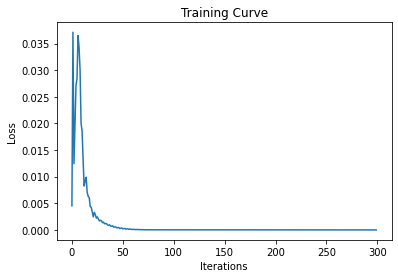

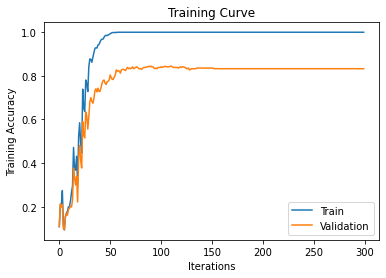

Final Training Accuracy: 1.0
Final Validation Accuracy: 0.8328530259365994


In [ ]:
# Training
model = classification()
train_class(model, train_feats, train_labels, batch_size = 512, num_epochs = 100, learning_rate = 0.0005, use_cuda = use_cuda)

Assuming the model has already been trained and saved, it can be loaded directly. The chosen model will be used on the test data.

In [ ]:
# Data loading & transformation of test data

# Set up data directory
dir = '/content/drive/My Drive/MIE1517 Project/Test Data/M2_Face_Cropped_Test/' # Root directory of the test data 

# Ensure all images are 224 x 224 by resizing them
data_transform = transforms.Compose([transforms.Resize((224, 224)), 
                                      transforms.ToTensor()])
new_data = datasets.ImageFolder(dir, transform = data_transform)

# Check number of test images
print('Number of new images: ', len(new_data))

# Load the images
img_loader = torch.utils.data.DataLoader(new_data, batch_size = len(new_data), shuffle = True)

# Split the data to the images and labels
dataiter = iter(img_loader)
images, name = dataiter.next()

Number of new images:  373


In [ ]:
# Compute the features of the test data
def resnet50_test_features(images, name, batch_size, use_cuda = False):
  imgs, labels = images, name

  #############################################
  # To Enable GPU Usage
  if use_cuda and torch.cuda.is_available():
    imgs = imgs.cuda()
    labels = labels.cuda()
    resnet50.cuda()
  #############################################

  features = resnet50(imgs)
  print(features.shape, labels.shape)
  
  return features, labels

In [ ]:
# Compute features for test data using ResNet50 and save them
new_test_features, new_test_labels = resnet50_test_features(images, name, use_cuda)
torch.save(new_test_features, '/content/drive/My Drive/MIE1517 Project/Test Data/Module 2-ResNet50/new_test_features')
torch.save(new_test_labels, '/content/drive/My Drive/MIE1517 Project/Test Data/Module 2-ResNet50/new_test_labels')

torch.Size([373, 2048, 7, 7]) torch.Size([373])


In [ ]:
# Load test data
new_test_features = torch.load('/content/drive/My Drive/MIE1517 Project/Test Data/Module 2-ResNet50/new_test_features')
new_test_labels = torch.load('/content/drive/My Drive/MIE1517 Project/Test Data/Module 2-ResNet50/new_test_labels')

new_test_loader = torch.utils.data.DataLoader(new_test_features, batch_size = len(new_test_features), shuffle = False)
new_test_label_loader = torch.utils.data.DataLoader(new_test_labels, batch_size = len(new_test_labels), shuffle = False)

In [ ]:
# Accuracy of test data
def test_get_accuracy_class(model, feature_loader, label_loader, use_cuda = False):

    correct = 0
    total = 0
    for feats, labels in zip(feature_loader, label_loader):  

        #############################################
        # To Enable GPU Usage
        if use_cuda and torch.cuda.is_available():
          feats = feats.cuda()
          labels = labels.cuda()
          model.cuda()
        #############################################
        
        output = model(feats)

        for i in range(len(output)):
          out = output[i].cpu().detach()
          prob_dist = torch.softmax(out, dim = 0)     # Use softmax to obtain the probabilities
          top3_prob, top3_class = torch.topk(prob_dist, 3)     # Obtain the largest 3 probabilities and the indices

          plt.imshow(np.transpose(images_np[i], (1, 2, 0)))     # Show the image from np array
          plt.title(classes[name[i]])     # Set the label class as title
          plt.axis('off')     # Don't show the axis of the plot
          plt.show()      # Show the image

          for n in range(3):      # Print the top 3 probabilities and the coresponding class
            print(classes[top3_class[n]], ':', top3_prob[n].numpy())          
          print('\n')

        pred = output.max(1, keepdim=True)[1] # Select index with maximum prediction score
        correct += pred.eq(labels.view_as(pred)).sum().item()
        total += feats.shape[0]
        i += 1
    return correct / total

The quantitative and qualitative results on the test data are shown below. Discussions will be made towards the end of the notebook.

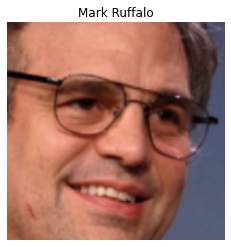

Robert Downey Jr : 0.500812
Mark Ruffalo : 0.4123722
Chris Hemsworth : 0.029898113




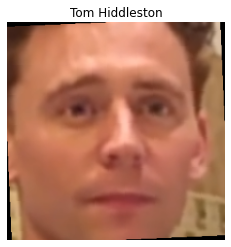

Tom Holland : 0.9966273
Scarlett Johansson : 0.0016890011
Chris Evans : 0.0014817058




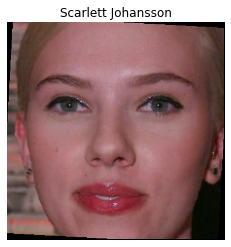

Scarlett Johansson : 0.9994442
Tom Holland : 0.00044661772
Elizabeth Olsen : 7.704295e-05




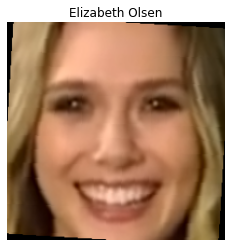

Elizabeth Olsen : 0.97594714
Anthony Mackie : 0.0118945325
Scarlett Johansson : 0.005325015




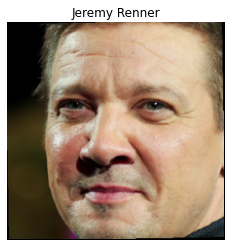

Jeremy Renner : 0.9867721
Chris Evans : 0.00941014
Tom Holland : 0.0020739776




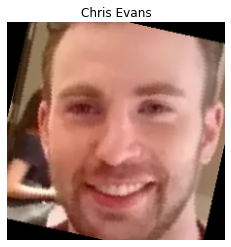

Chris Evans : 0.54958403
Tom Holland : 0.3139385
Elizabeth Olsen : 0.11393647




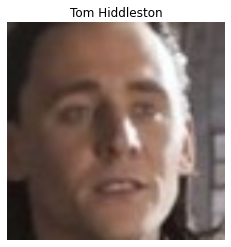

Robert Downey Jr : 0.7343357
Tom Hiddleston : 0.1774767
Chris Hemsworth : 0.031390425




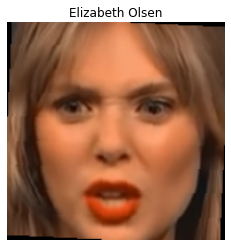

Elizabeth Olsen : 0.8048345
Scarlett Johansson : 0.19150554
Tom Hiddleston : 0.001703776




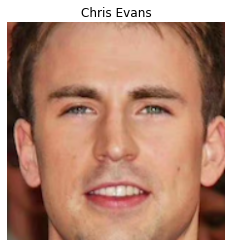

Chris Hemsworth : 0.44053483
Robert Downey Jr : 0.3885371
Tom Hiddleston : 0.16064556




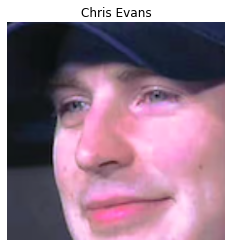

Chris Evans : 0.6935219
Jeremy Renner : 0.11936765
Tom Holland : 0.07662021




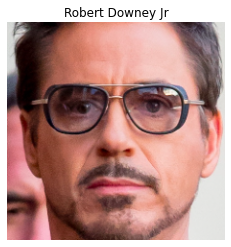

Robert Downey Jr : 0.9995752
Chris Hemsworth : 0.000359713
Chris Evans : 4.2230164e-05




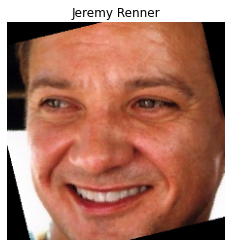

Jeremy Renner : 0.9779912
Anthony Mackie : 0.015784098
Mark Ruffalo : 0.0057748877




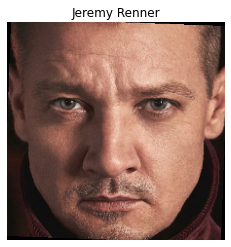

Jeremy Renner : 0.9999285
Tom Hiddleston : 4.3893855e-05
Anthony Mackie : 1.6471642e-05




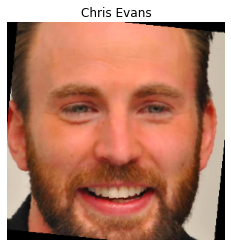

Chris Evans : 0.9931773
Chris Hemsworth : 0.006584577
Tom Hiddleston : 0.00012258207




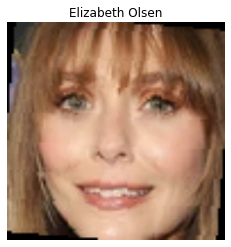

Elizabeth Olsen : 0.7310038
Scarlett Johansson : 0.12309589
Chris Hemsworth : 0.08946438




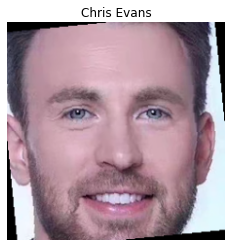

Chris Evans : 0.989292
Tom Hiddleston : 0.007907858
Mark Ruffalo : 0.0017383051




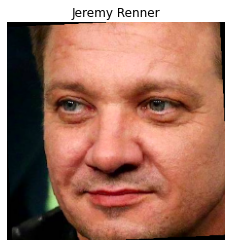

Jeremy Renner : 0.9999362
Tom Holland : 3.1243086e-05
Mark Ruffalo : 2.0807838e-05




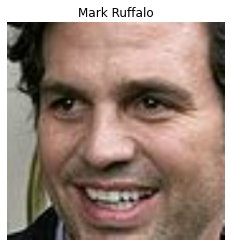

Mark Ruffalo : 0.9490855
Robert Downey Jr : 0.04319652
Tom Hiddleston : 0.0073142108




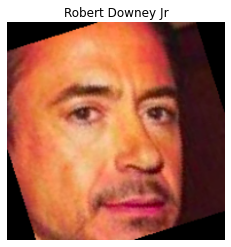

Robert Downey Jr : 0.88392556
Anthony Mackie : 0.072597936
Chris Evans : 0.017546507




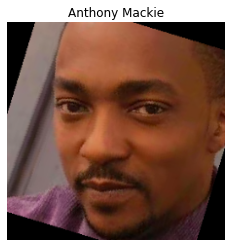

Anthony Mackie : 0.9998447
Mark Ruffalo : 0.00011298497
Robert Downey Jr : 3.2309545e-05




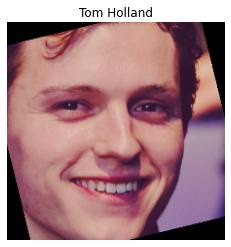

Tom Holland : 0.769041
Scarlett Johansson : 0.08760412
Robert Downey Jr : 0.0765498




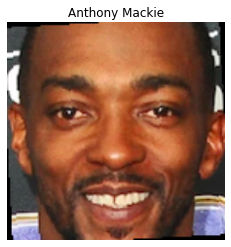

Anthony Mackie : 0.9971125
Mark Ruffalo : 0.0020540112
Tom Hiddleston : 0.00044675078




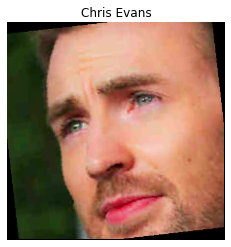

Chris Evans : 0.97471786
Tom Holland : 0.019261636
Scarlett Johansson : 0.0020938518




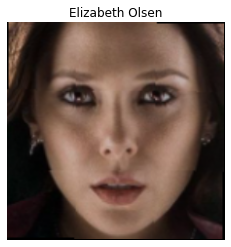

Scarlett Johansson : 0.8408976
Elizabeth Olsen : 0.15648952
Tom Hiddleston : 0.0008788686




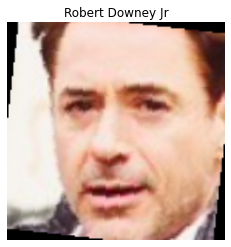

Jeremy Renner : 0.6719793
Tom Holland : 0.09781655
Chris Evans : 0.074010976




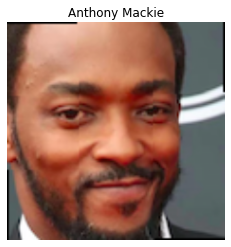

Anthony Mackie : 0.9625509
Mark Ruffalo : 0.016647715
Tom Hiddleston : 0.011272748




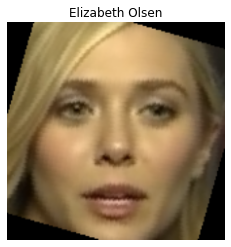

Elizabeth Olsen : 0.99998975
Tom Hiddleston : 5.6566832e-06
Robert Downey Jr : 2.163837e-06




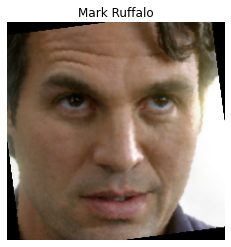

Mark Ruffalo : 0.9991555
Scarlett Johansson : 0.0005323965
Chris Evans : 0.000103854414




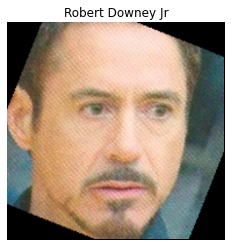

Jeremy Renner : 0.7723462
Tom Holland : 0.10651158
Chris Evans : 0.072798744




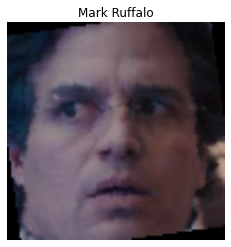

Tom Holland : 0.8827857
Chris Evans : 0.038780674
Tom Hiddleston : 0.022600992




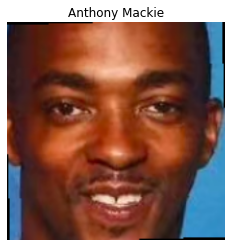

Anthony Mackie : 0.99999595
Mark Ruffalo : 1.6991092e-06
Tom Hiddleston : 1.3474687e-06




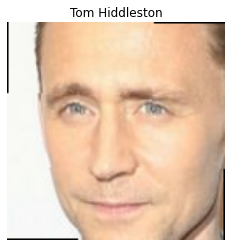

Tom Hiddleston : 0.892027
Jeremy Renner : 0.10783953
Robert Downey Jr : 6.520653e-05




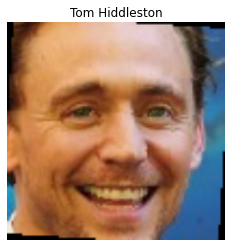

Tom Hiddleston : 0.9035053
Jeremy Renner : 0.06249403
Tom Holland : 0.011800855




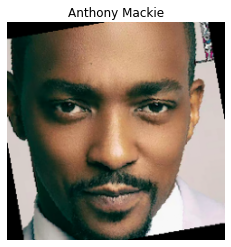

Anthony Mackie : 0.9945194
Mark Ruffalo : 0.0029416108
Tom Hiddleston : 0.0015563696




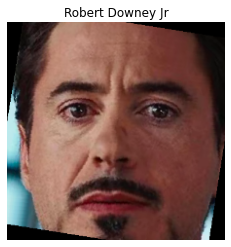

Robert Downey Jr : 0.9991763
Chris Hemsworth : 0.00045512032
Mark Ruffalo : 0.00018852




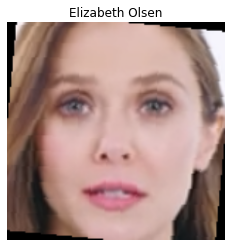

Elizabeth Olsen : 0.9979044
Tom Hiddleston : 0.0014532215
Scarlett Johansson : 0.00052723225




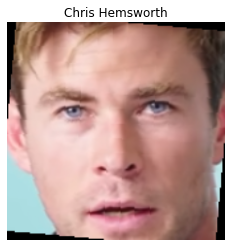

Chris Hemsworth : 0.9331788
Tom Hiddleston : 0.0593356
Chris Evans : 0.0035721345




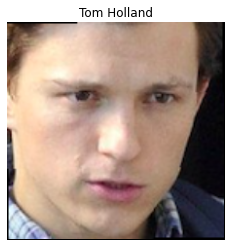

Jeremy Renner : 0.54982555
Tom Holland : 0.2709453
Mark Ruffalo : 0.14704436




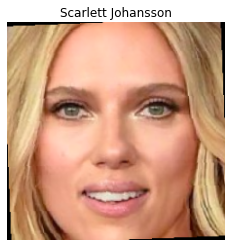

Scarlett Johansson : 0.9999747
Elizabeth Olsen : 2.5227631e-05
Chris Hemsworth : 2.1764807e-08




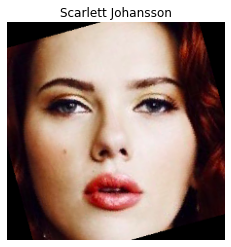

Scarlett Johansson : 0.9954171
Elizabeth Olsen : 0.00447259
Tom Holland : 8.480355e-05




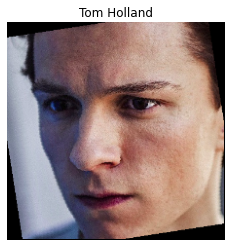

Chris Evans : 0.46511176
Chris Hemsworth : 0.43472296
Mark Ruffalo : 0.056227334




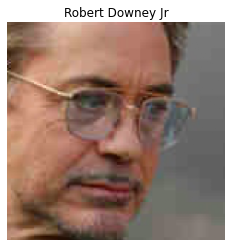

Robert Downey Jr : 0.49421751
Mark Ruffalo : 0.21620038
Tom Hiddleston : 0.19372639




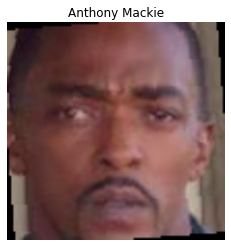

Robert Downey Jr : 0.36404818
Tom Hiddleston : 0.26401633
Anthony Mackie : 0.20321317




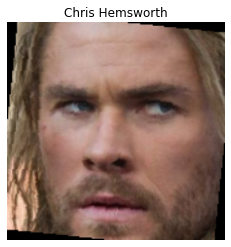

Chris Hemsworth : 0.9999442
Chris Evans : 4.6598405e-05
Tom Hiddleston : 4.3705513e-06




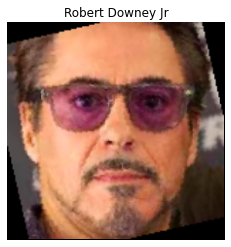

Robert Downey Jr : 0.9857955
Mark Ruffalo : 0.01340722
Chris Hemsworth : 0.0006941998




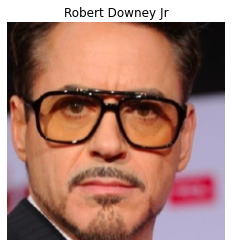

Robert Downey Jr : 0.996816
Tom Hiddleston : 0.002293184
Chris Hemsworth : 0.0005238933




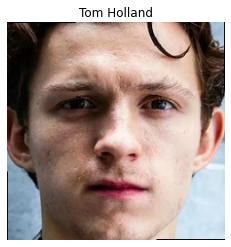

Chris Evans : 0.74825186
Jeremy Renner : 0.11614788
Tom Holland : 0.106542535




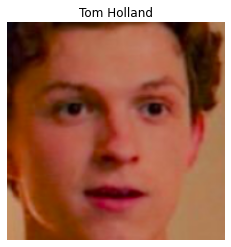

Tom Holland : 0.98147935
Scarlett Johansson : 0.006109803
Tom Hiddleston : 0.0052414467




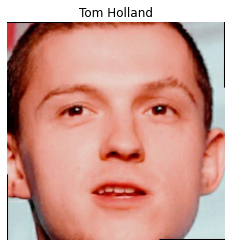

Tom Holland : 0.96089196
Chris Evans : 0.033226747
Jeremy Renner : 0.0049085277




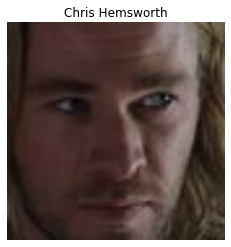

Chris Hemsworth : 0.96846694
Elizabeth Olsen : 0.012968198
Robert Downey Jr : 0.011929683




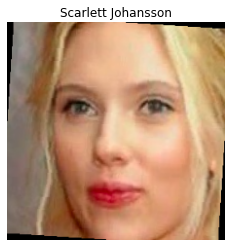

Scarlett Johansson : 0.9301423
Elizabeth Olsen : 0.06432387
Tom Holland : 0.005074386




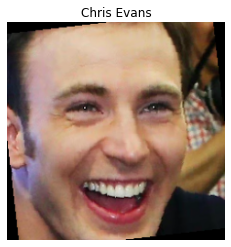

Chris Evans : 0.70239353
Mark Ruffalo : 0.2443998
Tom Holland : 0.032061014




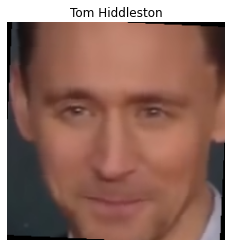

Tom Hiddleston : 0.98567015
Robert Downey Jr : 0.012461178
Tom Holland : 0.00047881092




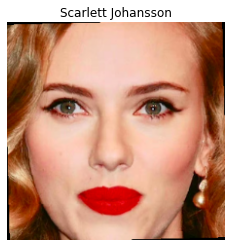

Scarlett Johansson : 0.99999964
Elizabeth Olsen : 3.2053782e-07
Tom Hiddleston : 3.057963e-09




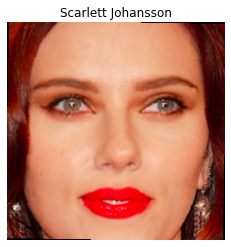

Scarlett Johansson : 0.9911724
Elizabeth Olsen : 0.006820919
Chris Evans : 0.0014036003




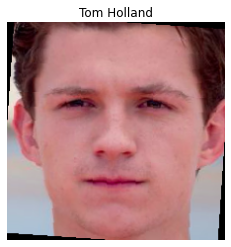

Tom Holland : 0.95267314
Tom Hiddleston : 0.046758447
Jeremy Renner : 0.00023151113




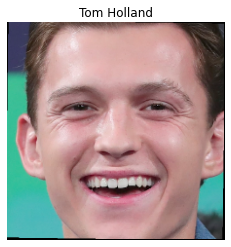

Tom Holland : 0.9474874
Chris Evans : 0.021366771
Jeremy Renner : 0.011786668




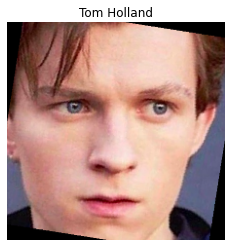

Tom Holland : 0.9981975
Chris Hemsworth : 0.00069549936
Tom Hiddleston : 0.00035671986




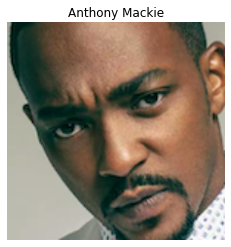

Jeremy Renner : 0.75826
Anthony Mackie : 0.13840681
Tom Hiddleston : 0.08742714




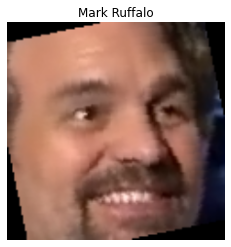

Mark Ruffalo : 0.7495938
Chris Evans : 0.09214161
Robert Downey Jr : 0.07690338




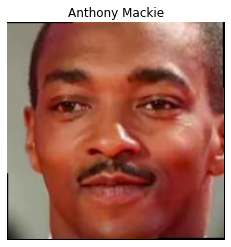

Anthony Mackie : 0.9992212
Tom Hiddleston : 0.0004972415
Tom Holland : 0.00012952456




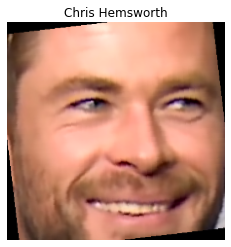

Chris Hemsworth : 0.3695965
Chris Evans : 0.24827974
Scarlett Johansson : 0.16031183




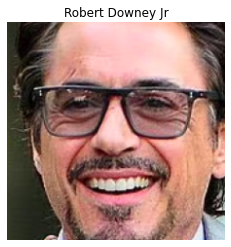

Robert Downey Jr : 0.9998461
Chris Hemsworth : 0.00013129986
Mark Ruffalo : 1.9459205e-05




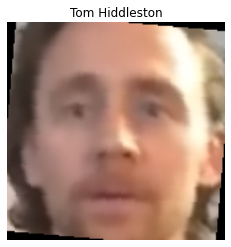

Tom Holland : 0.86750066
Elizabeth Olsen : 0.07109071
Tom Hiddleston : 0.047163304




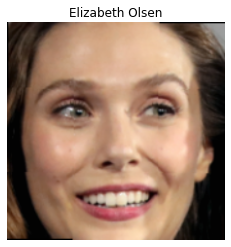

Elizabeth Olsen : 0.9022041
Scarlett Johansson : 0.09007791
Chris Evans : 0.0044728876




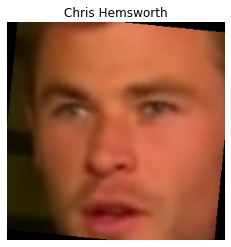

Chris Hemsworth : 0.5113789
Tom Hiddleston : 0.31637603
Elizabeth Olsen : 0.049352616




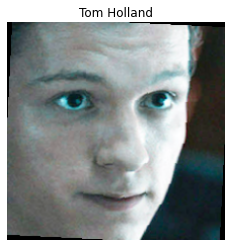

Tom Holland : 0.9778119
Scarlett Johansson : 0.011360532
Jeremy Renner : 0.003899941




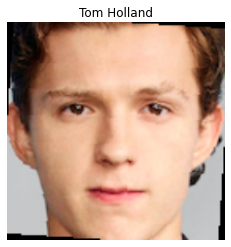

Tom Hiddleston : 0.89145553
Tom Holland : 0.10479059
Robert Downey Jr : 0.0011586894




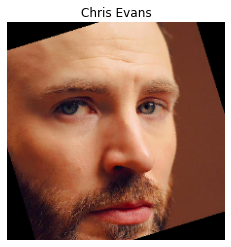

Chris Evans : 0.9843701
Tom Holland : 0.00820234
Scarlett Johansson : 0.0040218965




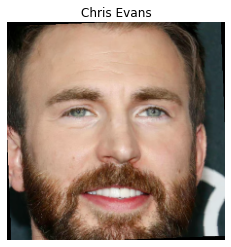

Chris Evans : 0.99580294
Chris Hemsworth : 0.0041898224
Mark Ruffalo : 5.4111924e-06




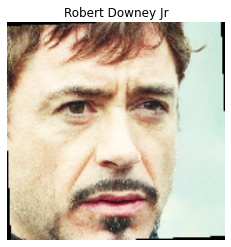

Robert Downey Jr : 0.46733645
Chris Hemsworth : 0.29323393
Mark Ruffalo : 0.2348497




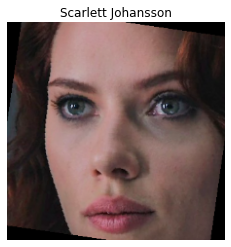

Scarlett Johansson : 0.61454
Elizabeth Olsen : 0.38388813
Tom Holland : 0.0010951655




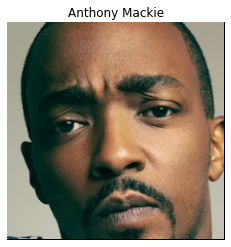

Anthony Mackie : 0.9996804
Jeremy Renner : 0.00030898338
Tom Hiddleston : 7.813087e-06




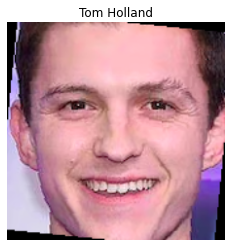

Jeremy Renner : 0.67984635
Tom Holland : 0.18766578
Tom Hiddleston : 0.07337913




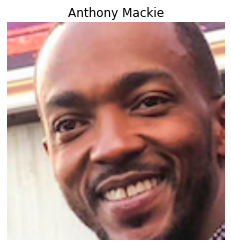

Anthony Mackie : 0.98834443
Elizabeth Olsen : 0.0078051686
Robert Downey Jr : 0.002681905




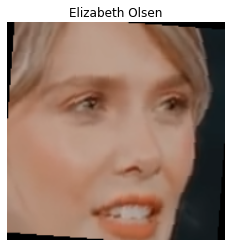

Elizabeth Olsen : 0.44342083
Tom Holland : 0.41451564
Tom Hiddleston : 0.088651516




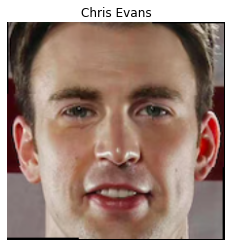

Chris Evans : 0.92204696
Tom Holland : 0.05655048
Jeremy Renner : 0.01654579




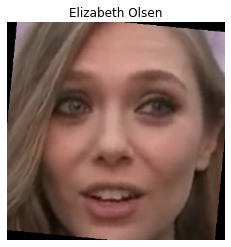

Elizabeth Olsen : 0.9976745
Scarlett Johansson : 0.0012535792
Tom Hiddleston : 0.0010371289




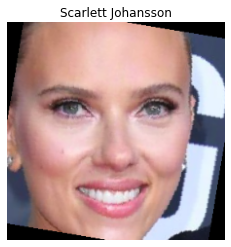

Elizabeth Olsen : 0.5444742
Scarlett Johansson : 0.32383555
Tom Holland : 0.07336944




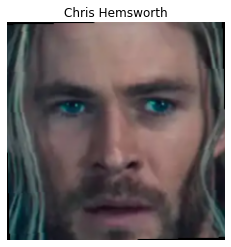

Chris Hemsworth : 0.5028494
Elizabeth Olsen : 0.47026843
Scarlett Johansson : 0.021311443




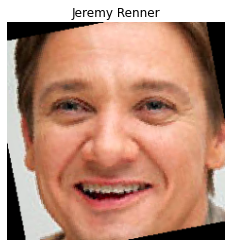

Jeremy Renner : 0.76979846
Scarlett Johansson : 0.07879141
Elizabeth Olsen : 0.07627991




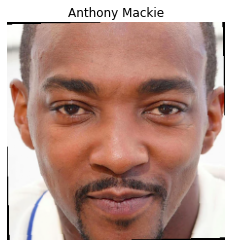

Anthony Mackie : 0.9996164
Tom Hiddleston : 0.00022518645
Jeremy Renner : 0.00012571858




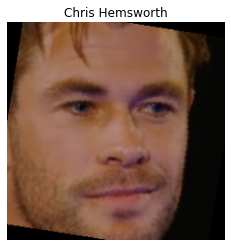

Tom Hiddleston : 0.43103665
Chris Hemsworth : 0.18420838
Scarlett Johansson : 0.1581359




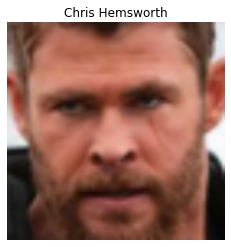

Chris Hemsworth : 0.99980384
Tom Hiddleston : 0.00017269194
Chris Evans : 1.2960149e-05




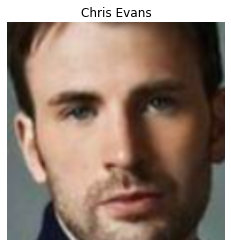

Chris Evans : 0.46134955
Chris Hemsworth : 0.3919895
Robert Downey Jr : 0.12813084




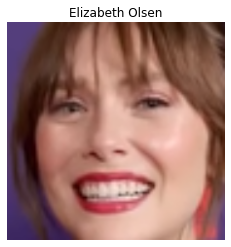

Scarlett Johansson : 0.99609864
Elizabeth Olsen : 0.0020501935
Tom Holland : 0.00078509655




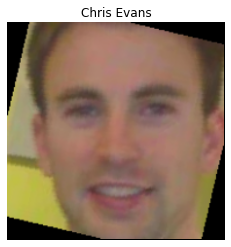

Chris Evans : 0.4786091
Chris Hemsworth : 0.22005823
Elizabeth Olsen : 0.2118165




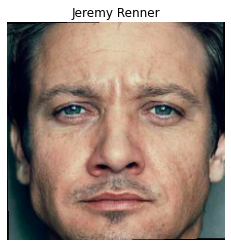

Chris Hemsworth : 0.6111364
Jeremy Renner : 0.29403827
Chris Evans : 0.054595742




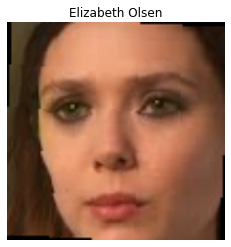

Elizabeth Olsen : 0.80056185
Scarlett Johansson : 0.08441269
Tom Holland : 0.05447966




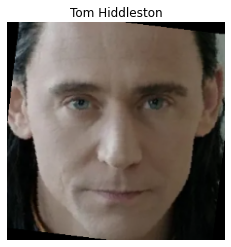

Tom Hiddleston : 0.9986318
Elizabeth Olsen : 0.00102445
Scarlett Johansson : 0.00015307132




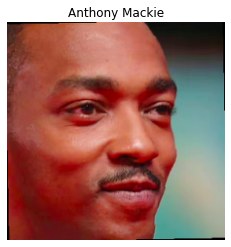

Anthony Mackie : 0.9960263
Tom Holland : 0.001987769
Jeremy Renner : 0.0007050605




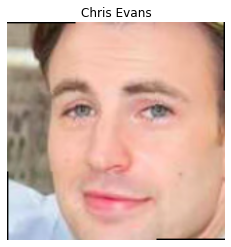

Tom Hiddleston : 0.5818587
Chris Hemsworth : 0.22310114
Chris Evans : 0.16571826




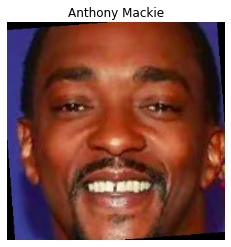

Anthony Mackie : 0.99265623
Robert Downey Jr : 0.0065928632
Elizabeth Olsen : 0.0002677249




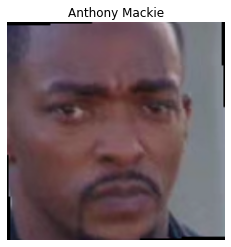

Anthony Mackie : 0.91204363
Elizabeth Olsen : 0.036580447
Robert Downey Jr : 0.017519267




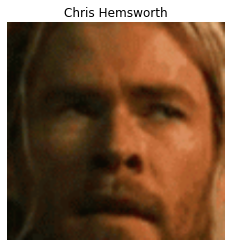

Elizabeth Olsen : 0.7225199
Chris Hemsworth : 0.21871834
Tom Holland : 0.029054487




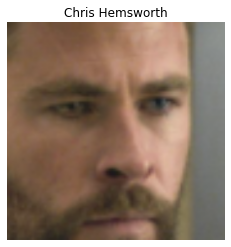

Chris Hemsworth : 0.9414691
Chris Evans : 0.052731507
Tom Hiddleston : 0.004482881




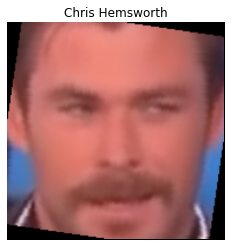

Tom Hiddleston : 0.30056632
Chris Evans : 0.24164948
Tom Holland : 0.14626202




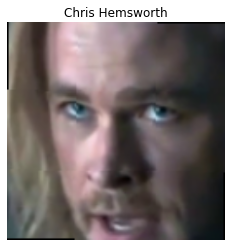

Chris Evans : 0.35090357
Scarlett Johansson : 0.3301623
Elizabeth Olsen : 0.10562232




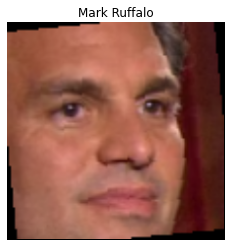

Mark Ruffalo : 0.96977925
Anthony Mackie : 0.012363759
Tom Hiddleston : 0.0062421462




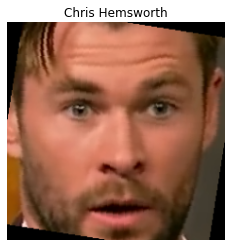

Chris Hemsworth : 0.93622845
Tom Hiddleston : 0.04702158
Mark Ruffalo : 0.009974819




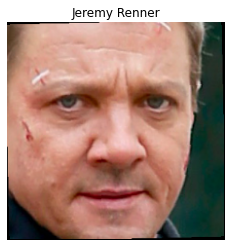

Jeremy Renner : 0.92975855
Tom Hiddleston : 0.05589937
Mark Ruffalo : 0.012273479




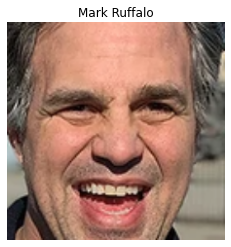

Mark Ruffalo : 0.99528426
Chris Hemsworth : 0.0025537878
Tom Hiddleston : 0.0015439414




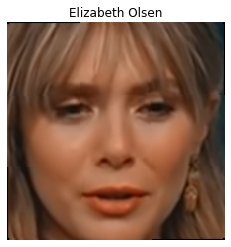

Scarlett Johansson : 0.64189327
Elizabeth Olsen : 0.20144652
Jeremy Renner : 0.110807635




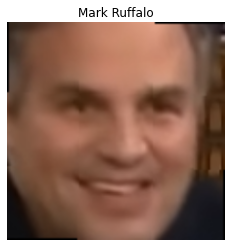

Mark Ruffalo : 0.69904035
Tom Holland : 0.18118745
Jeremy Renner : 0.07195369




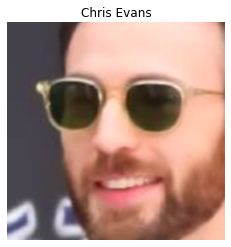

Chris Evans : 0.93433976
Robert Downey Jr : 0.055565532
Chris Hemsworth : 0.0046786205




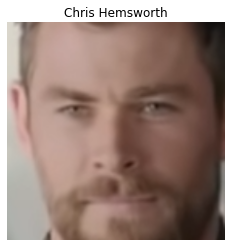

Chris Hemsworth : 0.51553863
Tom Hiddleston : 0.18230784
Tom Holland : 0.09751575




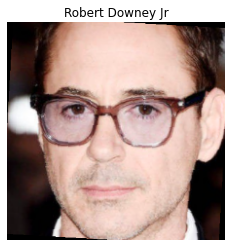

Robert Downey Jr : 0.9999901
Tom Hiddleston : 3.529952e-06
Chris Hemsworth : 3.2228086e-06




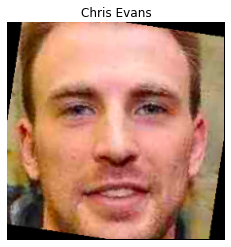

Chris Evans : 0.9609649
Tom Holland : 0.010713888
Jeremy Renner : 0.009532666




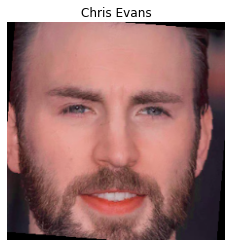

Chris Evans : 0.80104345
Chris Hemsworth : 0.19886261
Robert Downey Jr : 6.210976e-05




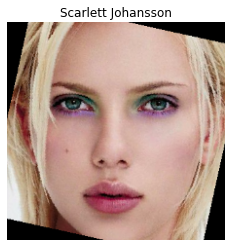

Scarlett Johansson : 0.99557424
Elizabeth Olsen : 0.0044205603
Chris Hemsworth : 5.0649087e-06




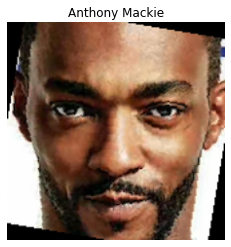

Anthony Mackie : 0.9903071
Robert Downey Jr : 0.008153322
Tom Hiddleston : 0.00074265513




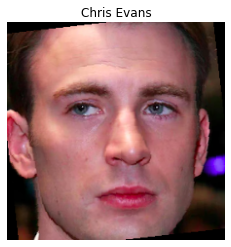

Mark Ruffalo : 0.7072939
Chris Evans : 0.24742171
Tom Hiddleston : 0.021150248




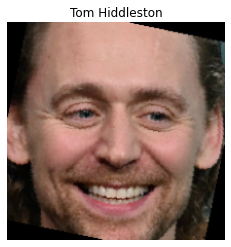

Tom Hiddleston : 0.89475155
Mark Ruffalo : 0.10148445
Chris Hemsworth : 0.002901956




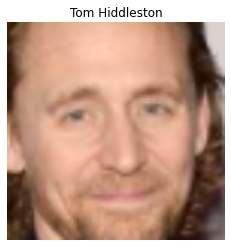

Robert Downey Jr : 0.9803889
Tom Hiddleston : 0.015442668
Jeremy Renner : 0.0023991575




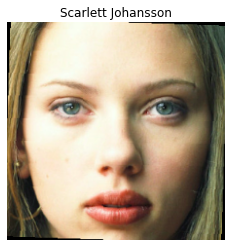

Scarlett Johansson : 0.99530315
Elizabeth Olsen : 0.004691625
Tom Holland : 3.1007778e-06




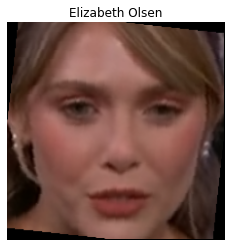

Elizabeth Olsen : 0.6022585
Scarlett Johansson : 0.38572285
Robert Downey Jr : 0.0060304874




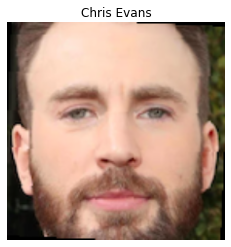

Chris Evans : 0.9956767
Chris Hemsworth : 0.003812993
Tom Hiddleston : 0.0002033467




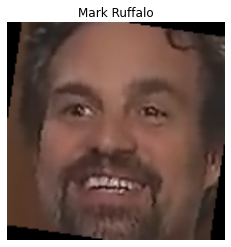

Chris Hemsworth : 0.63515866
Elizabeth Olsen : 0.24696334
Robert Downey Jr : 0.06294922




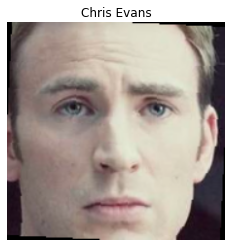

Chris Evans : 0.9957178
Tom Hiddleston : 0.002613138
Chris Hemsworth : 0.0008923526




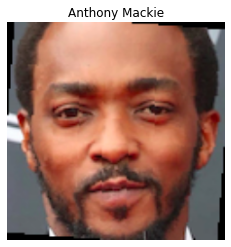

Anthony Mackie : 0.8261607
Mark Ruffalo : 0.170214
Robert Downey Jr : 0.0028518748




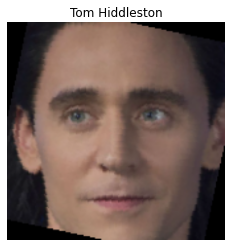

Tom Hiddleston : 0.77385134
Robert Downey Jr : 0.20546164
Elizabeth Olsen : 0.020594757




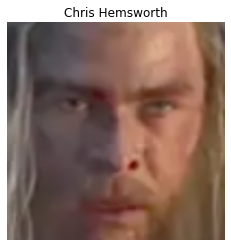

Chris Hemsworth : 0.992438
Elizabeth Olsen : 0.0037018303
Tom Hiddleston : 0.0019928992




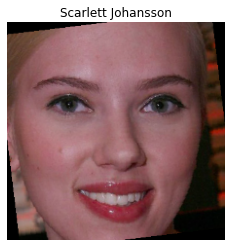

Scarlett Johansson : 0.9996598
Tom Holland : 0.00014603324
Chris Evans : 0.00010407185




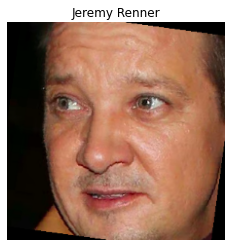

Jeremy Renner : 0.7277526
Mark Ruffalo : 0.24423629
Anthony Mackie : 0.025804041




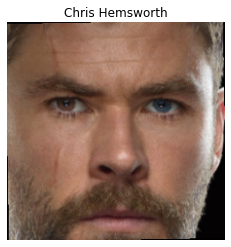

Chris Hemsworth : 0.99885035
Chris Evans : 0.0007944432
Jeremy Renner : 0.00012324983




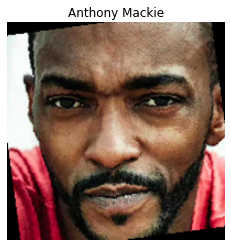

Robert Downey Jr : 0.8026138
Jeremy Renner : 0.08379251
Mark Ruffalo : 0.07147014




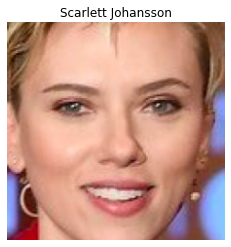

Scarlett Johansson : 0.9816264
Robert Downey Jr : 0.012403276
Elizabeth Olsen : 0.0026378913




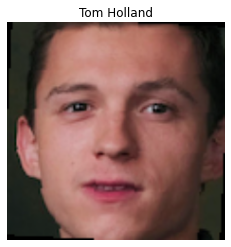

Tom Holland : 0.49302208
Jeremy Renner : 0.397143
Chris Hemsworth : 0.08695535




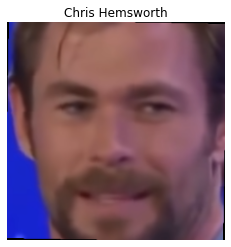

Tom Holland : 0.61411524
Chris Evans : 0.12728074
Tom Hiddleston : 0.10424165




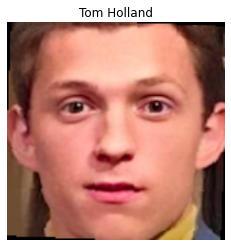

Tom Hiddleston : 0.7431589
Tom Holland : 0.18656963
Mark Ruffalo : 0.03894638




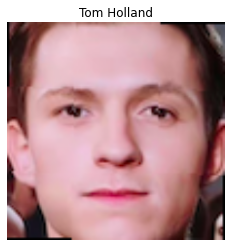

Tom Holland : 0.9977373
Chris Evans : 0.0022278125
Scarlett Johansson : 1.9072262e-05




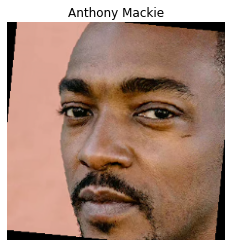

Anthony Mackie : 0.85605896
Mark Ruffalo : 0.07563245
Robert Downey Jr : 0.03626681




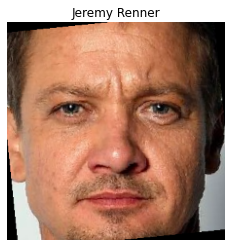

Jeremy Renner : 0.9911014
Tom Hiddleston : 0.0065383594
Mark Ruffalo : 0.0020560268




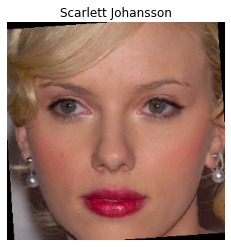

Scarlett Johansson : 0.9999877
Chris Evans : 4.1578824e-06
Elizabeth Olsen : 3.3666192e-06




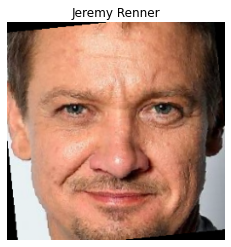

Jeremy Renner : 0.9983429
Mark Ruffalo : 0.0007503379
Tom Hiddleston : 0.00072208996




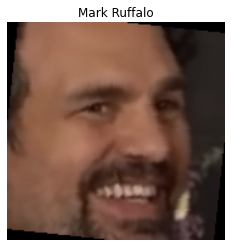

Mark Ruffalo : 0.9918366
Chris Hemsworth : 0.003054812
Chris Evans : 0.0017614673




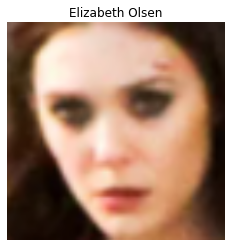

Elizabeth Olsen : 0.9792947
Scarlett Johansson : 0.007057948
Chris Evans : 0.0062863235




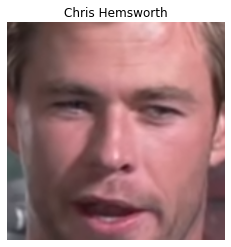

Chris Hemsworth : 0.91350734
Chris Evans : 0.04624783
Robert Downey Jr : 0.012440089




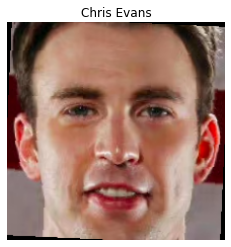

Chris Evans : 0.7470776
Tom Holland : 0.16514793
Tom Hiddleston : 0.060681947




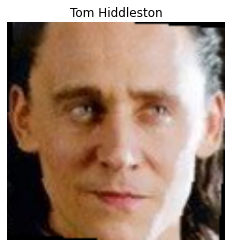

Tom Hiddleston : 0.99323213
Elizabeth Olsen : 0.0022303618
Mark Ruffalo : 0.0016517518




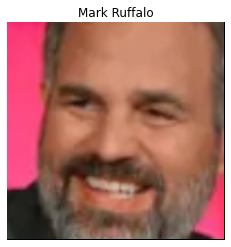

Chris Hemsworth : 0.7871917
Robert Downey Jr : 0.17864864
Chris Evans : 0.016764391




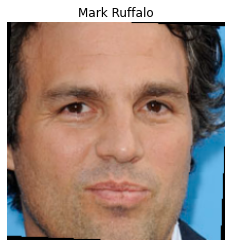

Mark Ruffalo : 0.9999509
Tom Hiddleston : 2.3237504e-05
Robert Downey Jr : 1.9499497e-05




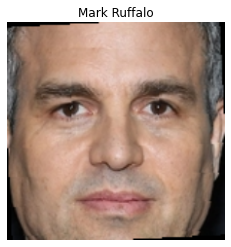

Mark Ruffalo : 0.99999
Scarlett Johansson : 2.8800462e-06
Jeremy Renner : 2.223446e-06




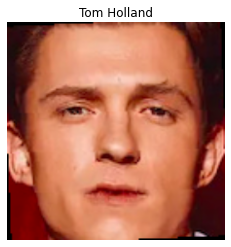

Tom Hiddleston : 0.5253651
Tom Holland : 0.38936853
Chris Evans : 0.04361437




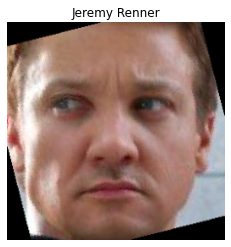

Jeremy Renner : 0.9665536
Scarlett Johansson : 0.01664827
Chris Hemsworth : 0.010316912




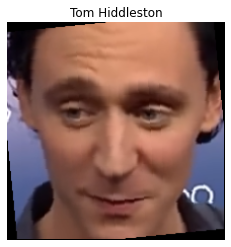

Tom Hiddleston : 0.98286736
Jeremy Renner : 0.00887795
Mark Ruffalo : 0.0038630958




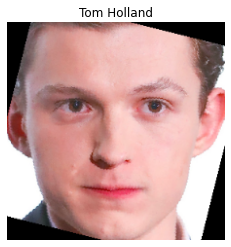

Tom Holland : 0.99446034
Scarlett Johansson : 0.0023639477
Chris Evans : 0.0016528325




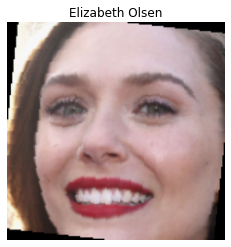

Elizabeth Olsen : 0.9992016
Scarlett Johansson : 0.0007679636
Tom Holland : 1.2457762e-05




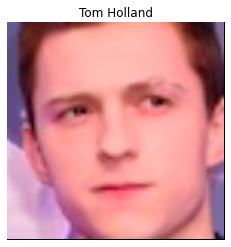

Tom Holland : 0.99333936
Chris Evans : 0.0032864432
Jeremy Renner : 0.003189832




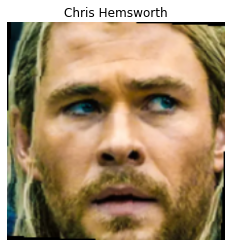

Chris Hemsworth : 0.99836165
Chris Evans : 0.0010087249
Scarlett Johansson : 0.00022740324




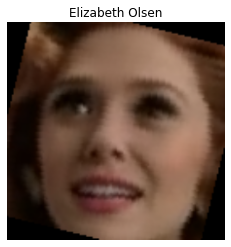

Elizabeth Olsen : 0.99103665
Tom Holland : 0.0039039685
Chris Evans : 0.0037342308




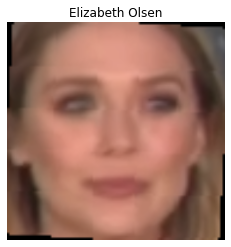

Elizabeth Olsen : 0.7385218
Tom Holland : 0.22531581
Robert Downey Jr : 0.019095888




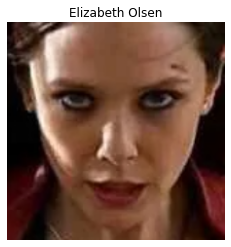

Anthony Mackie : 0.4605987
Tom Hiddleston : 0.18822949
Elizabeth Olsen : 0.17802061




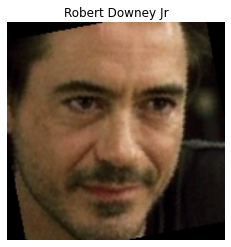

Robert Downey Jr : 0.38914704
Mark Ruffalo : 0.33154413
Tom Hiddleston : 0.22877103




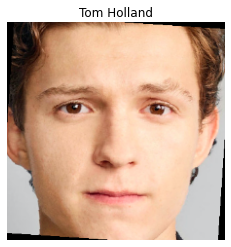

Tom Holland : 0.9968731
Jeremy Renner : 0.0025526362
Tom Hiddleston : 0.00040269725




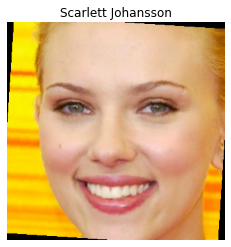

Tom Holland : 0.9939845
Scarlett Johansson : 0.004431872
Jeremy Renner : 0.0013114451




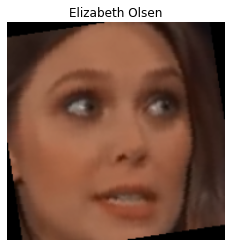

Elizabeth Olsen : 0.9807786
Scarlett Johansson : 0.014158725
Tom Hiddleston : 0.0018758712




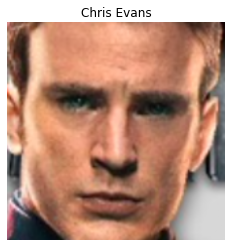

Jeremy Renner : 0.9303967
Chris Evans : 0.03208465
Chris Hemsworth : 0.015455601




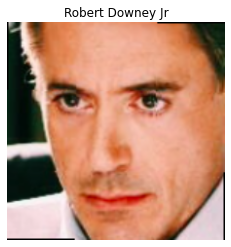

Jeremy Renner : 0.47424164
Tom Hiddleston : 0.44657162
Robert Downey Jr : 0.06848601




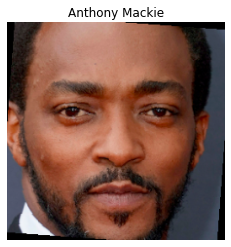

Anthony Mackie : 0.9947666
Mark Ruffalo : 0.0049782675
Robert Downey Jr : 0.000118387456




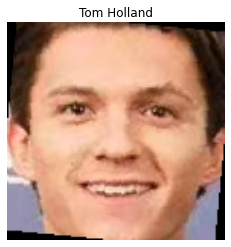

Tom Holland : 0.7377905
Jeremy Renner : 0.20852812
Mark Ruffalo : 0.028171882




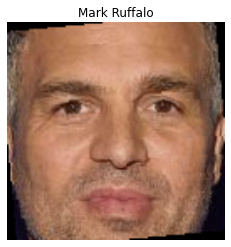

Mark Ruffalo : 0.9979382
Chris Hemsworth : 0.0014910904
Scarlett Johansson : 0.0002688309




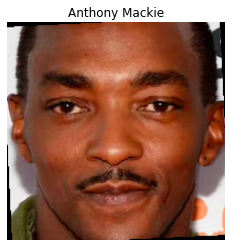

Anthony Mackie : 0.9999542
Jeremy Renner : 3.3559045e-05
Tom Hiddleston : 9.483383e-06




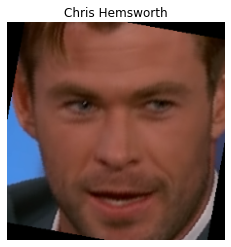

Chris Hemsworth : 0.5262052
Tom Hiddleston : 0.47100583
Mark Ruffalo : 0.0011367765




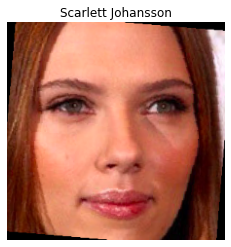

Elizabeth Olsen : 0.87214047
Scarlett Johansson : 0.12721406
Chris Hemsworth : 0.00031828257




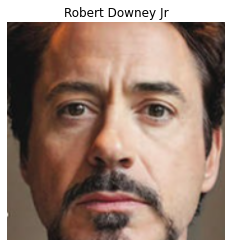

Robert Downey Jr : 0.99978036
Tom Hiddleston : 0.00014048802
Chris Evans : 3.8055958e-05




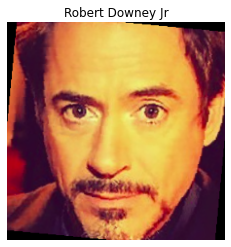

Robert Downey Jr : 0.96143025
Tom Hiddleston : 0.025040003
Elizabeth Olsen : 0.00895553




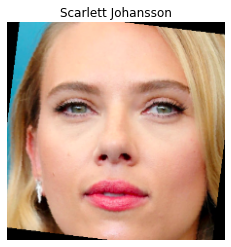

Scarlett Johansson : 0.9619234
Elizabeth Olsen : 0.038060702
Chris Evans : 5.3401486e-06




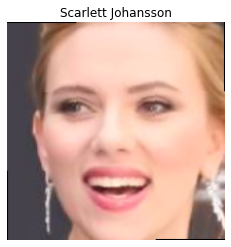

Scarlett Johansson : 0.9376058
Tom Holland : 0.04390771
Jeremy Renner : 0.005749771




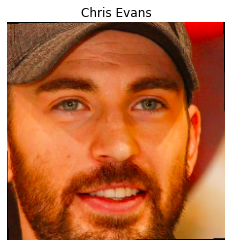

Chris Evans : 0.90403867
Mark Ruffalo : 0.042400673
Chris Hemsworth : 0.023089122




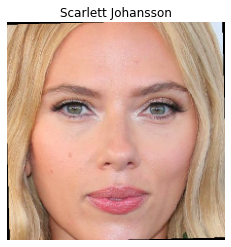

Scarlett Johansson : 0.8579322
Elizabeth Olsen : 0.1420674
Tom Hiddleston : 3.2264106e-07




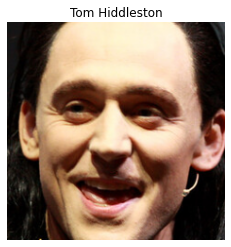

Chris Evans : 0.9379393
Robert Downey Jr : 0.035960477
Tom Hiddleston : 0.01804406




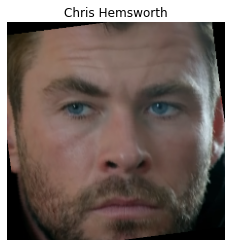

Chris Hemsworth : 0.99911886
Tom Hiddleston : 0.00065293413
Chris Evans : 0.00018884006




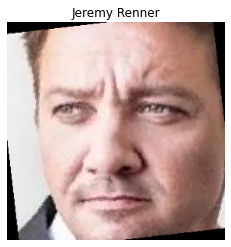

Jeremy Renner : 0.99932015
Tom Hiddleston : 0.00048157902
Chris Evans : 4.5852317e-05




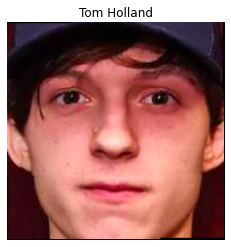

Tom Holland : 0.9922105
Anthony Mackie : 0.0037673675
Jeremy Renner : 0.0014201803




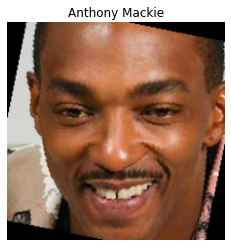

Anthony Mackie : 0.9998574
Jeremy Renner : 0.000102779
Mark Ruffalo : 2.2937491e-05




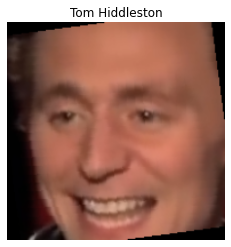

Anthony Mackie : 0.896217
Mark Ruffalo : 0.029792698
Tom Hiddleston : 0.026397837




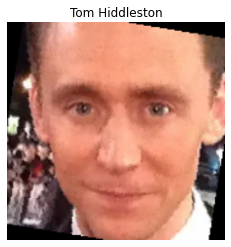

Tom Hiddleston : 0.9868721
Mark Ruffalo : 0.010303611
Jeremy Renner : 0.0017760214




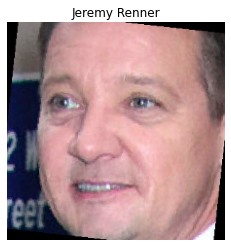

Jeremy Renner : 0.9960632
Scarlett Johansson : 0.0028226874
Tom Hiddleston : 0.0004935422




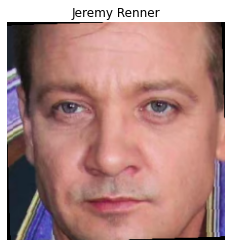

Jeremy Renner : 0.99990237
Tom Hiddleston : 8.804084e-05
Scarlett Johansson : 5.1967654e-06




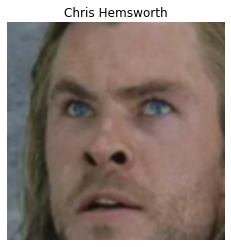

Chris Hemsworth : 0.6551487
Tom Hiddleston : 0.33668745
Elizabeth Olsen : 0.005326793




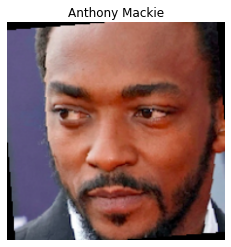

Anthony Mackie : 0.8894862
Mark Ruffalo : 0.08807992
Robert Downey Jr : 0.01075756




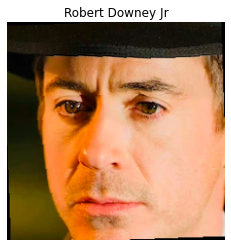

Tom Hiddleston : 0.9274815
Robert Downey Jr : 0.07151205
Chris Evans : 0.00037456985




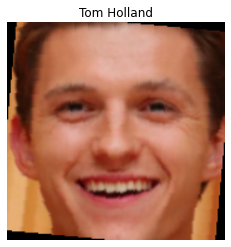

Tom Holland : 0.9977919
Chris Evans : 0.0009021483
Jeremy Renner : 0.00043872662




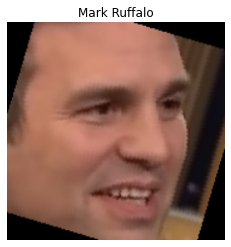

Tom Holland : 0.59545594
Elizabeth Olsen : 0.20916234
Tom Hiddleston : 0.05186635




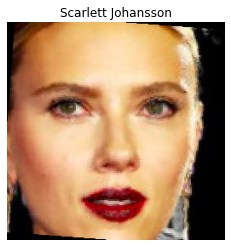

Scarlett Johansson : 0.9608575
Elizabeth Olsen : 0.024113568
Tom Holland : 0.014974868




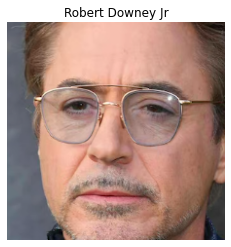

Robert Downey Jr : 0.72112536
Chris Hemsworth : 0.27790275
Chris Evans : 0.0008407304




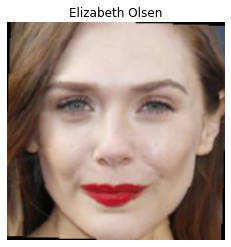

Elizabeth Olsen : 0.90617275
Scarlett Johansson : 0.085215874
Robert Downey Jr : 0.008045314




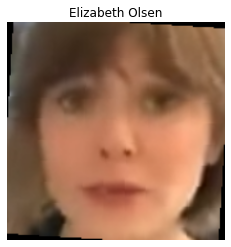

Tom Holland : 0.41540936
Chris Evans : 0.28465924
Mark Ruffalo : 0.2489254




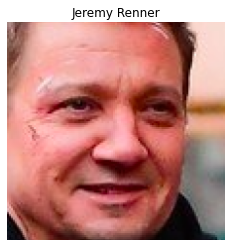

Robert Downey Jr : 0.3543138
Mark Ruffalo : 0.33633232
Jeremy Renner : 0.19649911




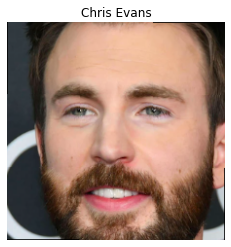

Chris Evans : 0.9976279
Chris Hemsworth : 0.0023170437
Tom Holland : 1.7664024e-05




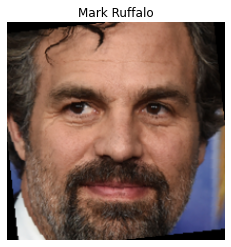

Mark Ruffalo : 0.99979085
Chris Hemsworth : 0.00015734677
Robert Downey Jr : 2.9431352e-05




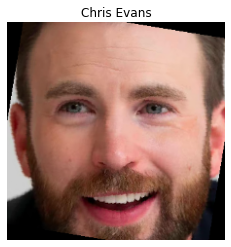

Chris Evans : 0.999946
Chris Hemsworth : 5.3577685e-05
Mark Ruffalo : 2.9189943e-07




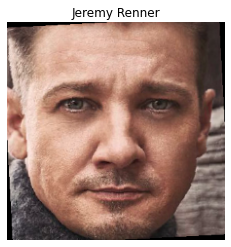

Jeremy Renner : 0.99405503
Mark Ruffalo : 0.0051412717
Tom Holland : 0.00027081993




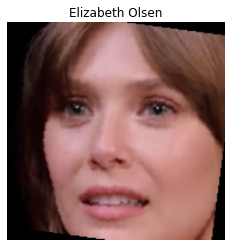

Elizabeth Olsen : 0.86878854
Scarlett Johansson : 0.12290412
Tom Holland : 0.006778199




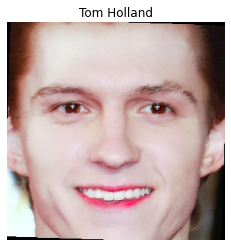

Tom Holland : 0.99359035
Chris Evans : 0.006007067
Jeremy Renner : 0.0003771662




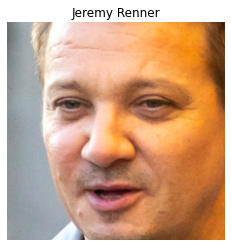

Jeremy Renner : 0.98978734
Scarlett Johansson : 0.007795997
Tom Hiddleston : 0.0012335317




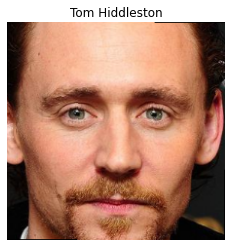

Tom Hiddleston : 0.77442193
Chris Hemsworth : 0.21903172
Robert Downey Jr : 0.0030389214




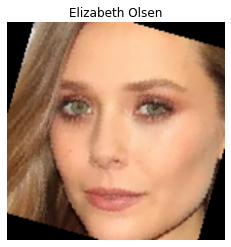

Elizabeth Olsen : 0.9997209
Scarlett Johansson : 0.00021666415
Robert Downey Jr : 5.2669777e-05




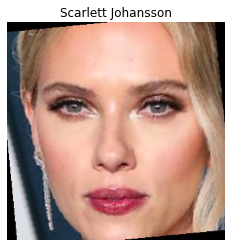

Scarlett Johansson : 0.9979062
Elizabeth Olsen : 0.0018902486
Mark Ruffalo : 0.00017853724




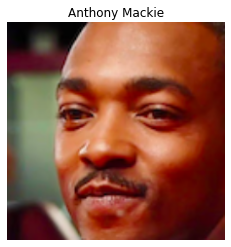

Anthony Mackie : 0.9966492
Robert Downey Jr : 0.0023048525
Mark Ruffalo : 0.0007208591




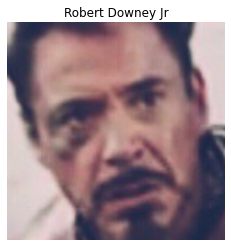

Jeremy Renner : 0.28519335
Tom Holland : 0.25474086
Robert Downey Jr : 0.23859699




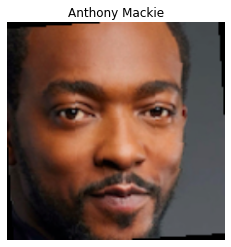

Anthony Mackie : 0.99953735
Mark Ruffalo : 0.0002721557
Robert Downey Jr : 0.0001645896




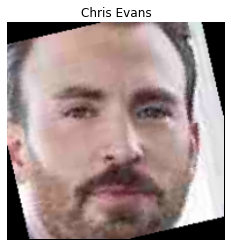

Scarlett Johansson : 0.4480041
Chris Evans : 0.37857494
Chris Hemsworth : 0.13654293




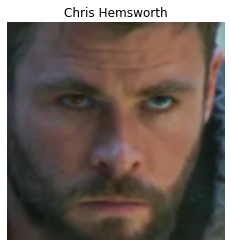

Chris Hemsworth : 0.9270197
Mark Ruffalo : 0.040990636
Tom Hiddleston : 0.018502183




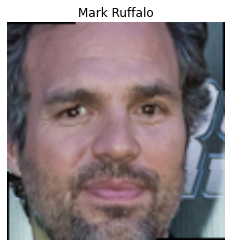

Mark Ruffalo : 0.9927303
Chris Hemsworth : 0.0030518128
Robert Downey Jr : 0.0021196802




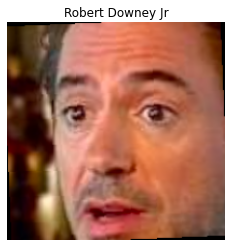

Tom Hiddleston : 0.6924743
Robert Downey Jr : 0.28056458
Mark Ruffalo : 0.0148937




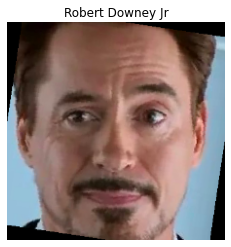

Chris Evans : 0.5278532
Chris Hemsworth : 0.23355784
Robert Downey Jr : 0.1359991




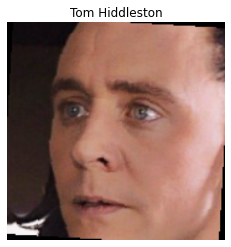

Tom Hiddleston : 0.9787402
Robert Downey Jr : 0.010841718
Chris Hemsworth : 0.007055937




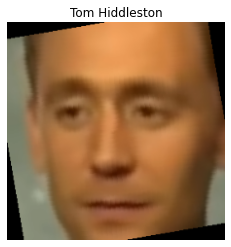

Tom Hiddleston : 0.83469325
Elizabeth Olsen : 0.067064606
Scarlett Johansson : 0.05270215




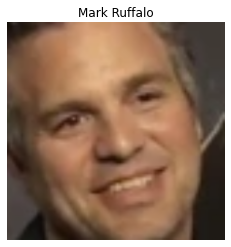

Mark Ruffalo : 0.50180686
Tom Hiddleston : 0.35663646
Anthony Mackie : 0.07579157




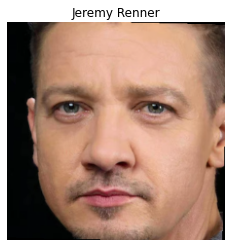

Jeremy Renner : 0.99983287
Chris Evans : 0.0001387368
Tom Holland : 2.12912e-05




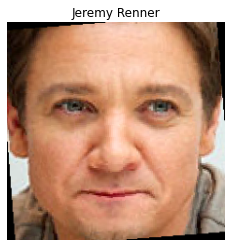

Jeremy Renner : 0.9695841
Scarlett Johansson : 0.01848687
Tom Holland : 0.009824223




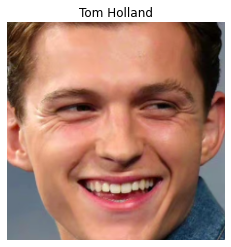

Tom Holland : 0.9928362
Chris Evans : 0.005945498
Jeremy Renner : 0.0004625254




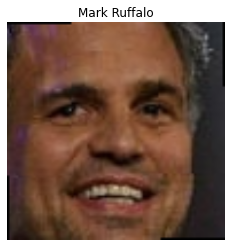

Mark Ruffalo : 0.6295127
Robert Downey Jr : 0.3449317
Tom Hiddleston : 0.01296613




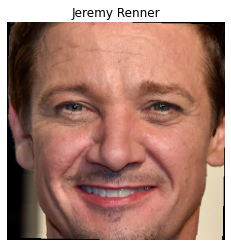

Jeremy Renner : 0.9896485
Tom Hiddleston : 0.008465207
Mark Ruffalo : 0.001255209




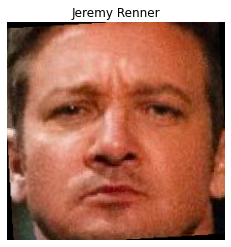

Jeremy Renner : 0.9987299
Anthony Mackie : 0.0005032709
Tom Holland : 0.00033721278




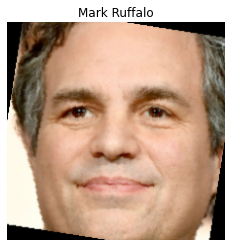

Mark Ruffalo : 0.9999949
Tom Hiddleston : 1.4526281e-06
Robert Downey Jr : 1.4012205e-06




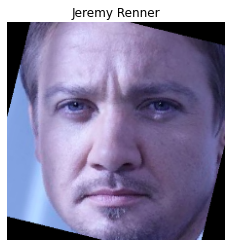

Jeremy Renner : 0.97334
Scarlett Johansson : 0.01338063
Tom Holland : 0.012634591




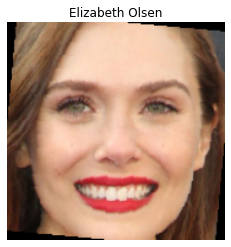

Elizabeth Olsen : 0.9999957
Scarlett Johansson : 3.852318e-06
Tom Holland : 3.8186934e-07




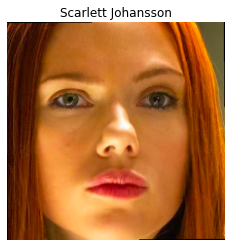

Scarlett Johansson : 0.9975672
Elizabeth Olsen : 0.0024319494
Anthony Mackie : 7.073708e-07




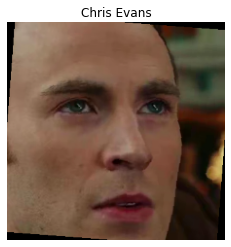

Chris Evans : 0.9421347
Tom Hiddleston : 0.04370531
Tom Holland : 0.008313072




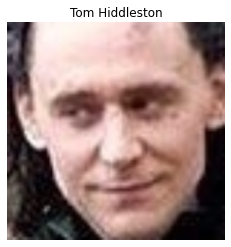

Tom Hiddleston : 0.9867063
Jeremy Renner : 0.012767314
Robert Downey Jr : 0.00021729668




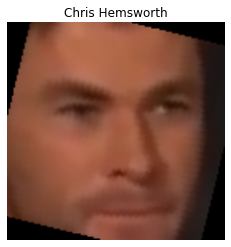

Tom Holland : 0.8128755
Elizabeth Olsen : 0.099382915
Chris Evans : 0.058703106




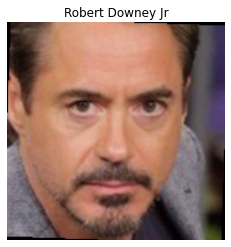

Robert Downey Jr : 0.9969721
Tom Hiddleston : 0.0018825497
Mark Ruffalo : 0.00091116846




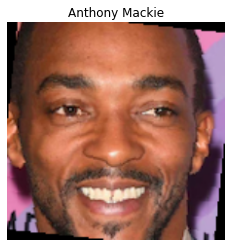

Anthony Mackie : 0.99980694
Mark Ruffalo : 8.969966e-05
Tom Hiddleston : 4.4525787e-05




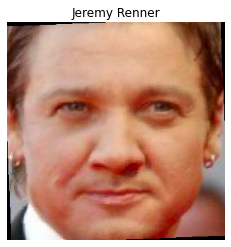

Jeremy Renner : 0.6438235
Tom Holland : 0.33523473
Scarlett Johansson : 0.017448071




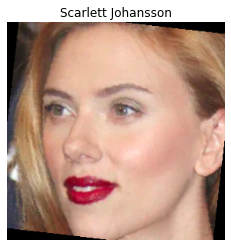

Scarlett Johansson : 0.9939698
Elizabeth Olsen : 0.0036963047
Tom Hiddleston : 0.0015911389




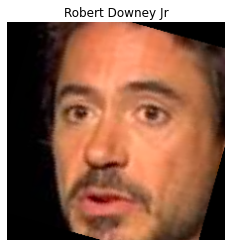

Robert Downey Jr : 0.9879116
Mark Ruffalo : 0.005570538
Anthony Mackie : 0.0030744926




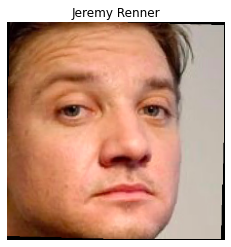

Jeremy Renner : 0.59916216
Tom Holland : 0.3870262
Chris Evans : 0.010359754




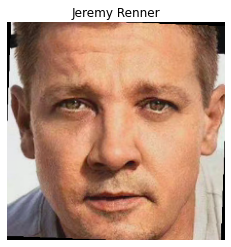

Jeremy Renner : 0.8551172
Tom Holland : 0.14396892
Chris Evans : 0.0007057805




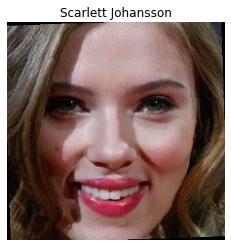

Scarlett Johansson : 0.79507965
Elizabeth Olsen : 0.20489383
Tom Holland : 1.4851271e-05




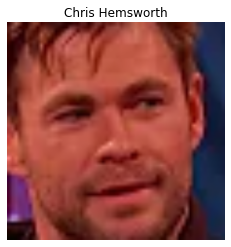

Tom Holland : 0.45893174
Robert Downey Jr : 0.3924618
Jeremy Renner : 0.043759063




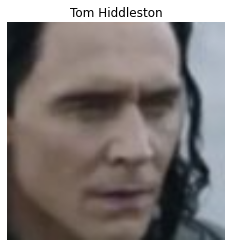

Tom Hiddleston : 0.47551745
Chris Evans : 0.21459799
Chris Hemsworth : 0.16764227




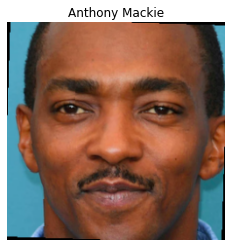

Anthony Mackie : 0.9999573
Mark Ruffalo : 2.4028377e-05
Tom Hiddleston : 1.6328555e-05




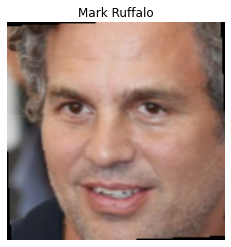

Mark Ruffalo : 0.9998883
Tom Hiddleston : 6.0374714e-05
Jeremy Renner : 2.5239337e-05




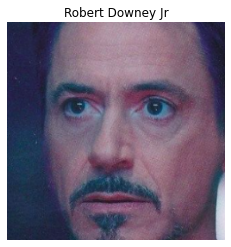

Robert Downey Jr : 0.99223775
Tom Hiddleston : 0.00768586
Jeremy Renner : 6.519391e-05




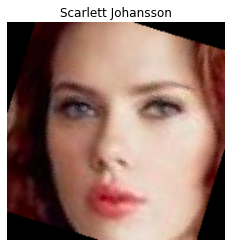

Elizabeth Olsen : 0.9409343
Scarlett Johansson : 0.02703095
Tom Holland : 0.0149353165




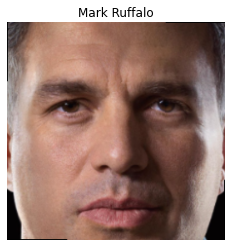

Mark Ruffalo : 0.99587065
Jeremy Renner : 0.0029692368
Chris Evans : 0.0005919809




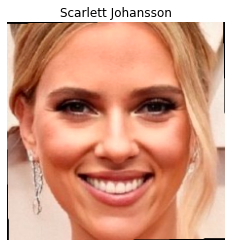

Scarlett Johansson : 0.9596785
Jeremy Renner : 0.0165584
Tom Holland : 0.010718721




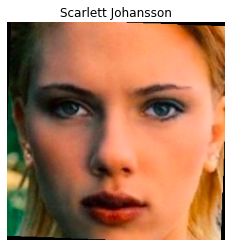

Scarlett Johansson : 0.9143096
Chris Evans : 0.06539916
Tom Holland : 0.0051207673




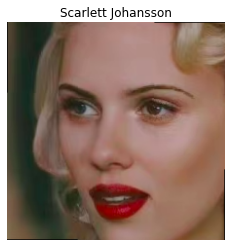

Scarlett Johansson : 0.99976355
Elizabeth Olsen : 0.00012962378
Tom Hiddleston : 5.7493715e-05




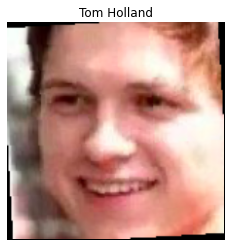

Mark Ruffalo : 0.7922541
Chris Evans : 0.11424686
Tom Holland : 0.048324227




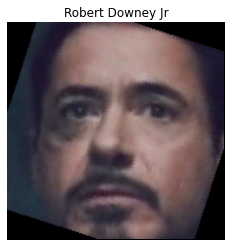

Elizabeth Olsen : 0.5984543
Chris Evans : 0.19069673
Chris Hemsworth : 0.09684513




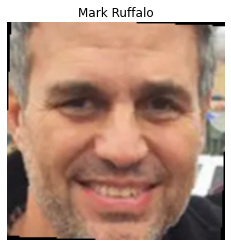

Mark Ruffalo : 0.9386842
Tom Hiddleston : 0.0576161
Jeremy Renner : 0.0023849458




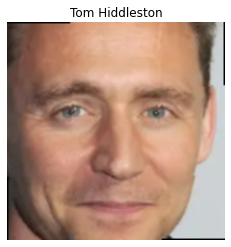

Tom Hiddleston : 0.5922536
Jeremy Renner : 0.40725613
Mark Ruffalo : 0.00020860133




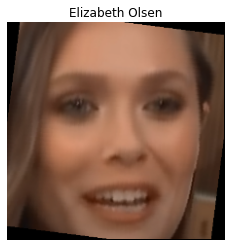

Elizabeth Olsen : 0.9999943
Tom Hiddleston : 2.2416618e-06
Anthony Mackie : 1.6384308e-06




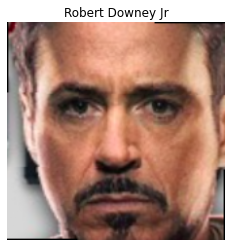

Robert Downey Jr : 0.9976058
Mark Ruffalo : 0.0018904484
Tom Hiddleston : 0.00033411413




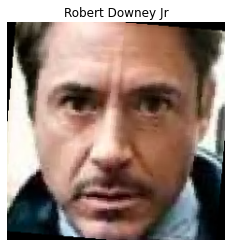

Robert Downey Jr : 0.98604256
Chris Hemsworth : 0.006409925
Chris Evans : 0.005847666




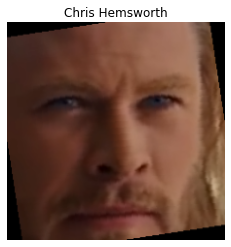

Chris Hemsworth : 0.9357209
Scarlett Johansson : 0.021824261
Chris Evans : 0.017989881




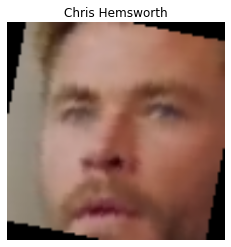

Chris Hemsworth : 0.65945894
Tom Holland : 0.26229936
Robert Downey Jr : 0.019624539




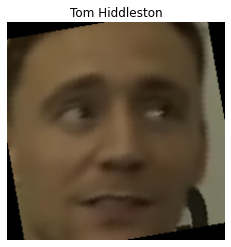

Tom Hiddleston : 0.41055423
Elizabeth Olsen : 0.38604817
Mark Ruffalo : 0.07015348




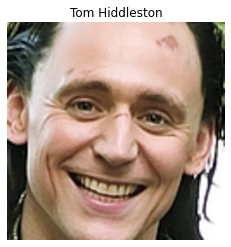

Tom Hiddleston : 0.42588347
Mark Ruffalo : 0.33661348
Chris Evans : 0.20947026




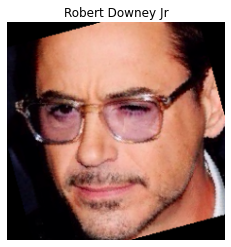

Robert Downey Jr : 0.99770147
Chris Hemsworth : 0.0020310187
Mark Ruffalo : 0.0002168764




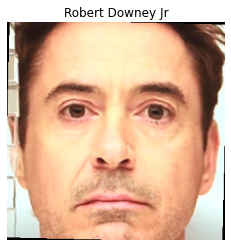

Robert Downey Jr : 0.3832474
Mark Ruffalo : 0.34568822
Chris Evans : 0.10348901




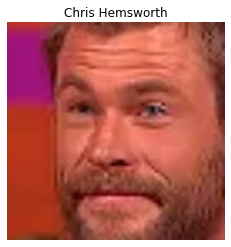

Jeremy Renner : 0.80615085
Robert Downey Jr : 0.115014024
Chris Hemsworth : 0.055751532




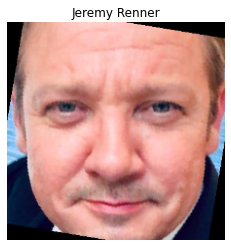

Jeremy Renner : 0.9995435
Tom Holland : 0.00043107118
Tom Hiddleston : 2.088215e-05




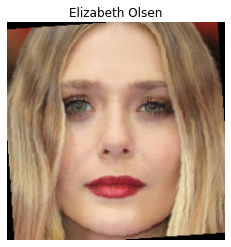

Elizabeth Olsen : 0.857296
Scarlett Johansson : 0.14268726
Chris Hemsworth : 9.692055e-06




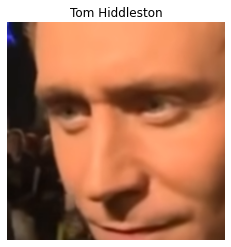

Tom Hiddleston : 0.88169086
Tom Holland : 0.064509846
Chris Evans : 0.014592503




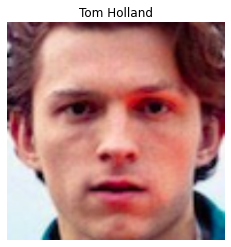

Tom Holland : 0.9494648
Tom Hiddleston : 0.027398277
Chris Hemsworth : 0.009693641




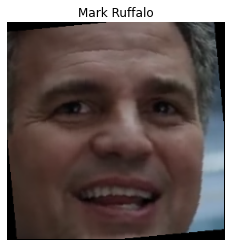

Mark Ruffalo : 0.95714945
Jeremy Renner : 0.021458773
Scarlett Johansson : 0.017187892




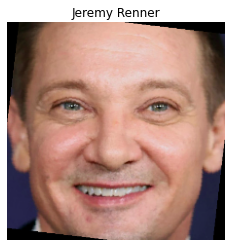

Jeremy Renner : 0.9675368
Tom Holland : 0.022369921
Mark Ruffalo : 0.0040293215




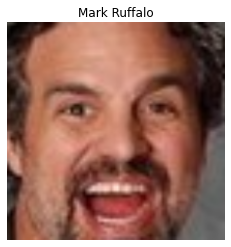

Robert Downey Jr : 0.7557476
Mark Ruffalo : 0.23772457
Chris Evans : 0.003351611




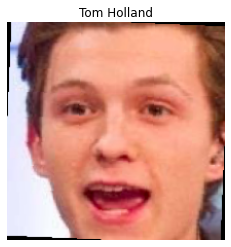

Tom Holland : 0.9985857
Chris Evans : 0.0010181629
Jeremy Renner : 0.00020806634




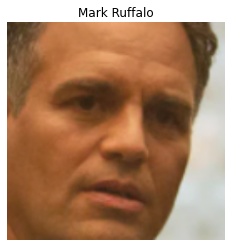

Mark Ruffalo : 0.9590717
Tom Hiddleston : 0.031958185
Chris Hemsworth : 0.007942727




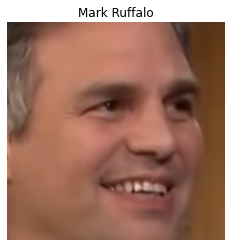

Mark Ruffalo : 0.9789843
Anthony Mackie : 0.015460765
Tom Holland : 0.0024618008




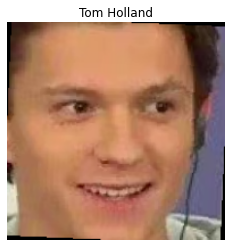

Tom Holland : 0.99715745
Jeremy Renner : 0.0018758873
Chris Evans : 0.00061905466




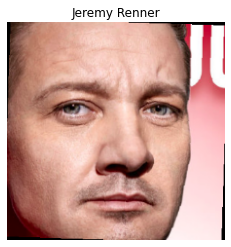

Jeremy Renner : 0.99503654
Tom Holland : 0.0047933804
Scarlett Johansson : 0.00011262666




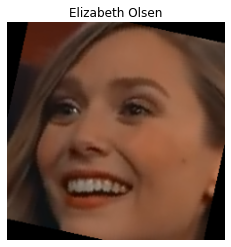

Elizabeth Olsen : 0.9954495
Tom Holland : 0.002554627
Anthony Mackie : 0.0010714752




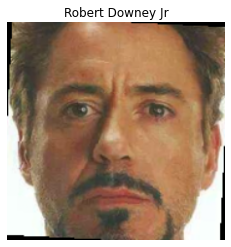

Tom Hiddleston : 0.54025215
Robert Downey Jr : 0.26523086
Mark Ruffalo : 0.089498535




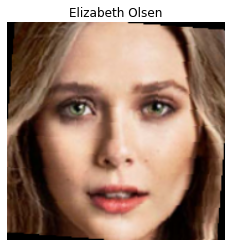

Elizabeth Olsen : 0.9979924
Chris Hemsworth : 0.0019556081
Tom Hiddleston : 4.2068667e-05




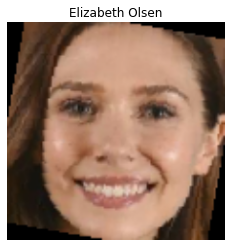

Elizabeth Olsen : 0.9975145
Tom Holland : 0.0012715445
Chris Hemsworth : 0.0003418229




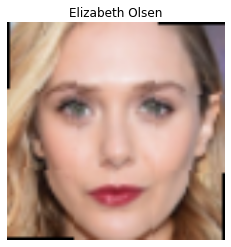

Elizabeth Olsen : 0.99549073
Scarlett Johansson : 0.002749903
Robert Downey Jr : 0.0011161318




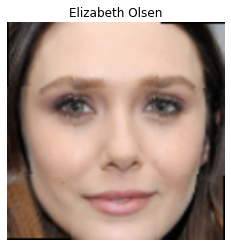

Elizabeth Olsen : 0.9923902
Scarlett Johansson : 0.0037220416
Tom Hiddleston : 0.0018766475




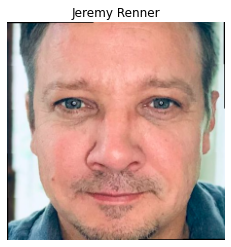

Jeremy Renner : 0.9999795
Anthony Mackie : 1.17497075e-05
Tom Holland : 4.440817e-06




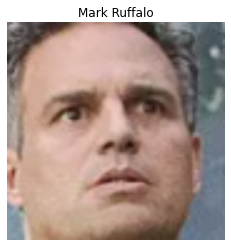

Mark Ruffalo : 0.9988193
Robert Downey Jr : 0.0008544885
Tom Hiddleston : 0.00024191823




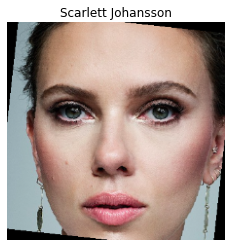

Scarlett Johansson : 0.75324494
Elizabeth Olsen : 0.22203918
Chris Evans : 0.016817098




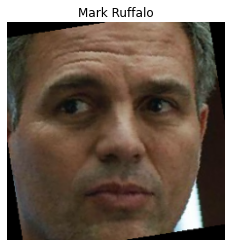

Mark Ruffalo : 0.9994493
Jeremy Renner : 0.00043811966
Robert Downey Jr : 4.4274893e-05




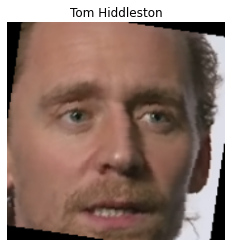

Tom Hiddleston : 0.99598086
Tom Holland : 0.0029944035
Chris Evans : 0.00036842207




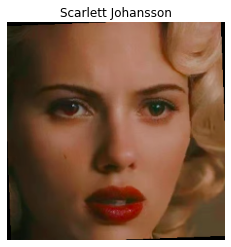

Scarlett Johansson : 0.7063206
Elizabeth Olsen : 0.2907136
Tom Holland : 0.002698766




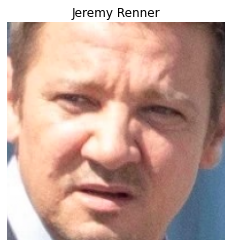

Jeremy Renner : 0.8759475
Tom Holland : 0.06562486
Mark Ruffalo : 0.023731755




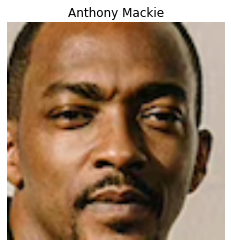

Anthony Mackie : 0.999877
Jeremy Renner : 0.00010330764
Robert Downey Jr : 5.488791e-06




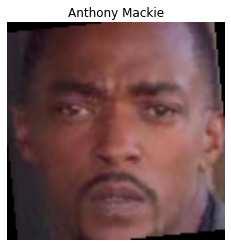

Robert Downey Jr : 0.52909374
Chris Hemsworth : 0.29277602
Anthony Mackie : 0.07597252




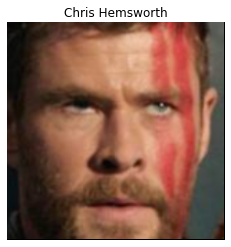

Chris Hemsworth : 0.9997459
Robert Downey Jr : 0.00011984508
Tom Holland : 5.9902683e-05




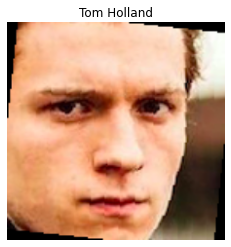

Tom Holland : 0.88380903
Jeremy Renner : 0.07261052
Tom Hiddleston : 0.022161521




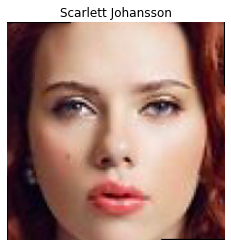

Scarlett Johansson : 0.9992913
Elizabeth Olsen : 0.0006039074
Tom Holland : 9.2051385e-05




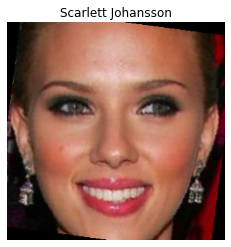

Scarlett Johansson : 0.8704452
Anthony Mackie : 0.107991874
Elizabeth Olsen : 0.0075566797




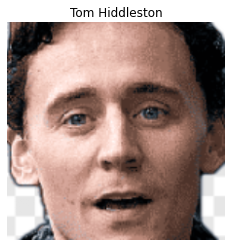

Tom Hiddleston : 0.955646
Robert Downey Jr : 0.03620461
Tom Holland : 0.0043591144




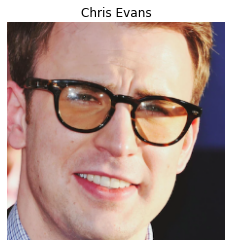

Chris Evans : 0.8160126
Tom Holland : 0.10179758
Tom Hiddleston : 0.054571964




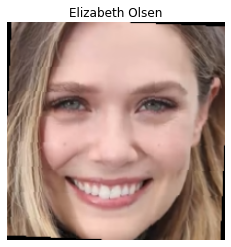

Elizabeth Olsen : 0.9998216
Scarlett Johansson : 0.00015793613
Chris Hemsworth : 1.35868695e-05




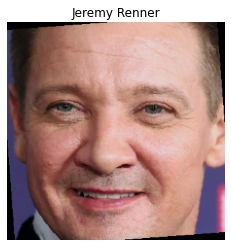

Jeremy Renner : 0.9233266
Mark Ruffalo : 0.048610087
Tom Hiddleston : 0.025662187




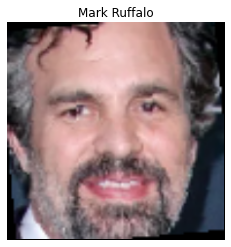

Mark Ruffalo : 0.993979
Robert Downey Jr : 0.005742179
Tom Hiddleston : 0.00014591425




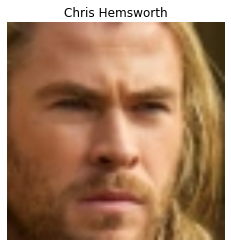

Chris Hemsworth : 0.99960476
Robert Downey Jr : 0.00018594338
Elizabeth Olsen : 9.811263e-05




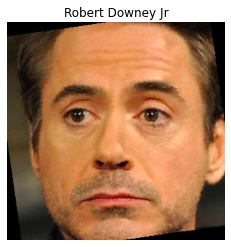

Robert Downey Jr : 0.52569205
Mark Ruffalo : 0.45594928
Chris Evans : 0.013209541




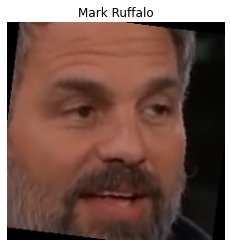

Mark Ruffalo : 0.9970355
Chris Hemsworth : 0.0013728869
Elizabeth Olsen : 0.0008180779




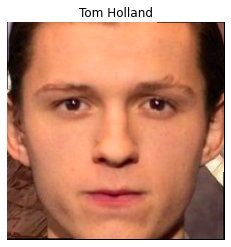

Tom Holland : 0.8579385
Tom Hiddleston : 0.124449596
Mark Ruffalo : 0.011863354




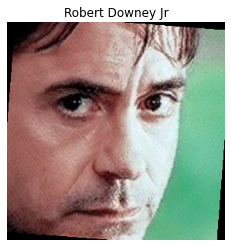

Tom Holland : 0.4705155
Elizabeth Olsen : 0.22242081
Scarlett Johansson : 0.123812355




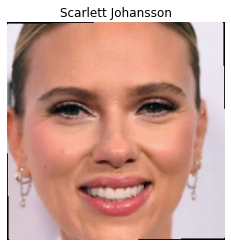

Scarlett Johansson : 0.67939365
Tom Holland : 0.13113932
Chris Evans : 0.1308023




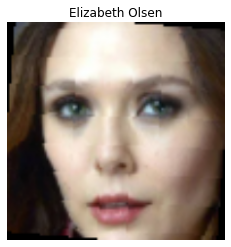

Elizabeth Olsen : 0.9999213
Scarlett Johansson : 7.507749e-05
Chris Hemsworth : 2.074461e-06




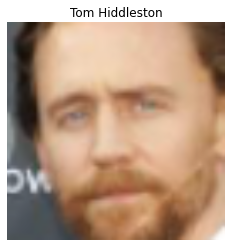

Jeremy Renner : 0.9748523
Robert Downey Jr : 0.011273112
Chris Evans : 0.0060502193




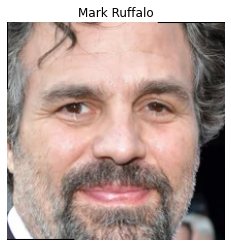

Mark Ruffalo : 0.99999046
Chris Evans : 4.1304966e-06
Chris Hemsworth : 4.003392e-06




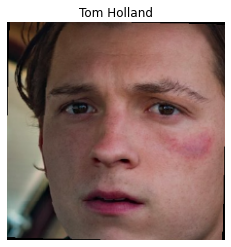

Chris Hemsworth : 0.35558054
Tom Holland : 0.3384761
Mark Ruffalo : 0.24399538




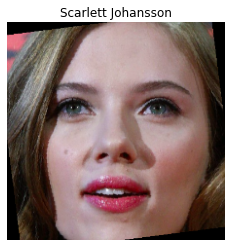

Elizabeth Olsen : 0.91223305
Scarlett Johansson : 0.087766625
Chris Hemsworth : 1.0254715e-07




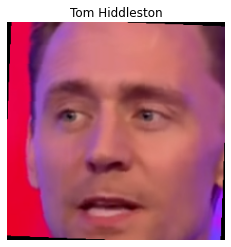

Tom Hiddleston : 0.99917847
Elizabeth Olsen : 0.00030558853
Chris Hemsworth : 0.00026297744




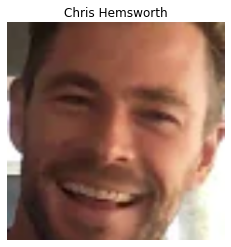

Mark Ruffalo : 0.25764948
Anthony Mackie : 0.25400284
Chris Hemsworth : 0.19895084




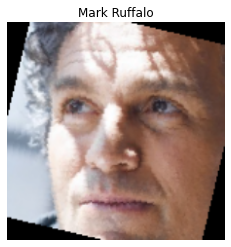

Jeremy Renner : 0.64010936
Mark Ruffalo : 0.21586433
Anthony Mackie : 0.06300306




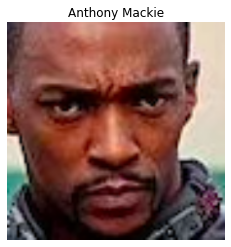

Anthony Mackie : 0.99705875
Mark Ruffalo : 0.0024116214
Jeremy Renner : 0.00020859927




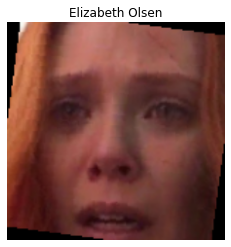

Scarlett Johansson : 0.4066985
Chris Hemsworth : 0.3385473
Elizabeth Olsen : 0.19026522




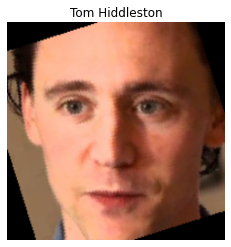

Robert Downey Jr : 0.75805455
Tom Hiddleston : 0.23164555
Elizabeth Olsen : 0.006361766




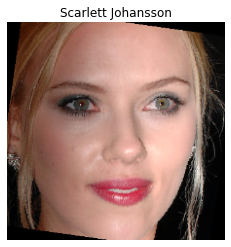

Scarlett Johansson : 0.7847375
Elizabeth Olsen : 0.21526162
Tom Holland : 4.5080054e-07




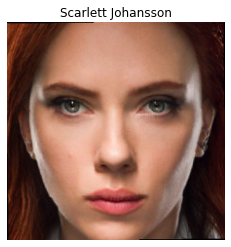

Scarlett Johansson : 0.97030646
Elizabeth Olsen : 0.029543819
Chris Hemsworth : 0.00012632884




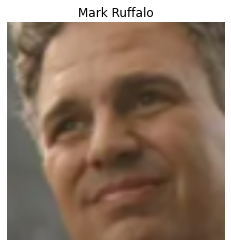

Jeremy Renner : 0.9941578
Chris Evans : 0.0047889734
Mark Ruffalo : 0.0005908894




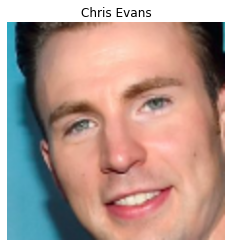

Chris Evans : 0.98615825
Jeremy Renner : 0.008540346
Chris Hemsworth : 0.0046550618




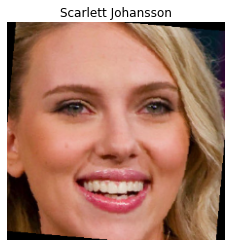

Scarlett Johansson : 0.8428058
Elizabeth Olsen : 0.14538635
Chris Evans : 0.006116002




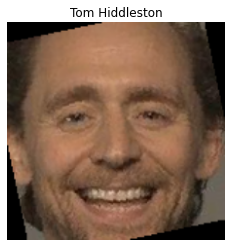

Mark Ruffalo : 0.83214843
Tom Hiddleston : 0.14370435
Robert Downey Jr : 0.020854553




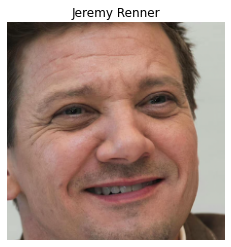

Mark Ruffalo : 0.5529584
Robert Downey Jr : 0.26373693
Jeremy Renner : 0.17652902




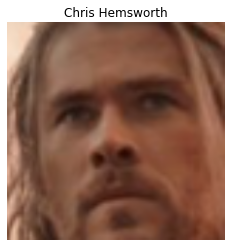

Elizabeth Olsen : 0.62846994
Tom Hiddleston : 0.19722882
Chris Hemsworth : 0.13907215




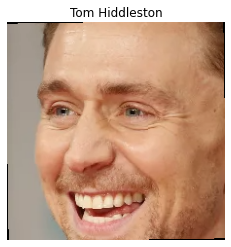

Tom Hiddleston : 0.7241645
Scarlett Johansson : 0.08568706
Elizabeth Olsen : 0.07497429




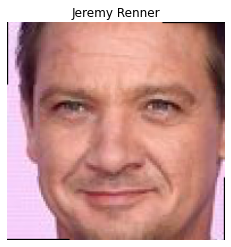

Jeremy Renner : 0.99960476
Anthony Mackie : 0.00023530587
Tom Holland : 0.0001439513




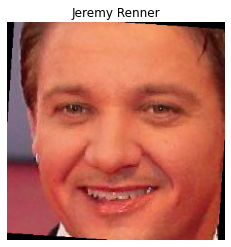

Jeremy Renner : 0.7942035
Tom Holland : 0.158369
Mark Ruffalo : 0.029350592




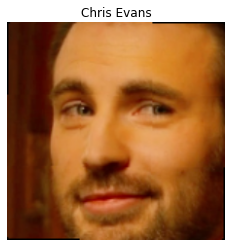

Chris Evans : 0.95829767
Chris Hemsworth : 0.030877385
Tom Hiddleston : 0.008009106




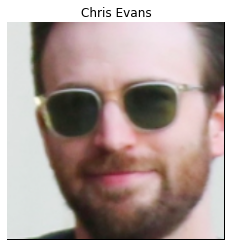

Chris Evans : 0.9749996
Robert Downey Jr : 0.011980765
Chris Hemsworth : 0.009090328




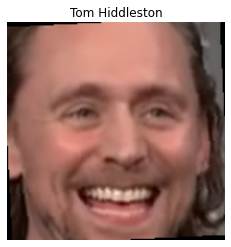

Chris Evans : 0.5076445
Tom Hiddleston : 0.16192123
Elizabeth Olsen : 0.1617409




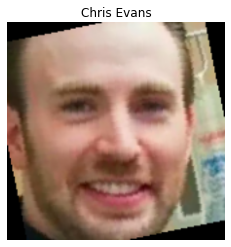

Chris Hemsworth : 0.6699905
Chris Evans : 0.2711635
Elizabeth Olsen : 0.03375185




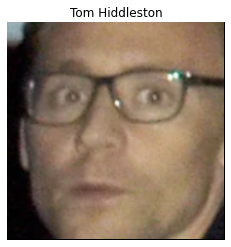

Tom Hiddleston : 0.9855768
Jeremy Renner : 0.005832281
Robert Downey Jr : 0.0042300248




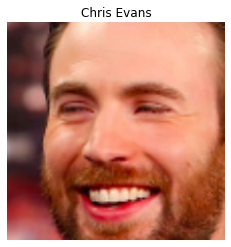

Chris Evans : 0.92268527
Chris Hemsworth : 0.06504804
Jeremy Renner : 0.006455996




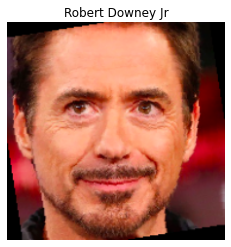

Robert Downey Jr : 0.5771539
Mark Ruffalo : 0.30325437
Chris Hemsworth : 0.06001204




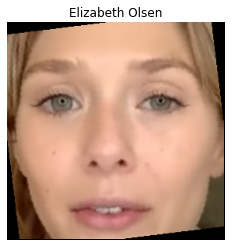

Scarlett Johansson : 0.88481474
Elizabeth Olsen : 0.11189966
Tom Hiddleston : 0.0030235087




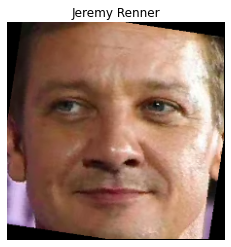

Jeremy Renner : 0.9710831
Tom Holland : 0.026295744
Anthony Mackie : 0.001049436




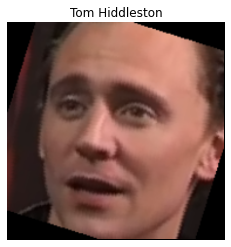

Elizabeth Olsen : 0.5690671
Robert Downey Jr : 0.2290984
Tom Hiddleston : 0.18334305




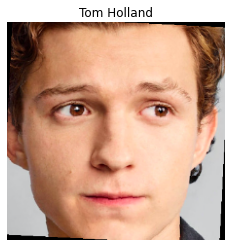

Tom Holland : 0.99993944
Tom Hiddleston : 1.8932791e-05
Jeremy Renner : 1.3400083e-05




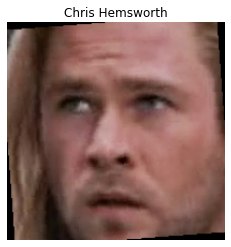

Chris Hemsworth : 0.93394053
Mark Ruffalo : 0.030582286
Elizabeth Olsen : 0.018000744




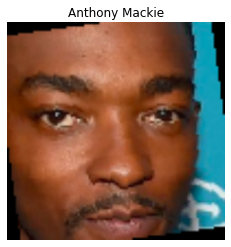

Anthony Mackie : 0.9997385
Jeremy Renner : 0.00015892046
Mark Ruffalo : 6.06704e-05




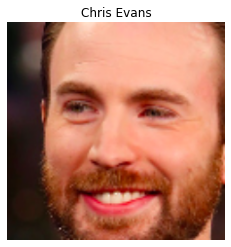

Chris Evans : 0.8613585
Chris Hemsworth : 0.13693774
Mark Ruffalo : 0.0015119071




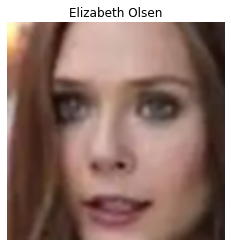

Elizabeth Olsen : 0.9880262
Scarlett Johansson : 0.010349873
Chris Hemsworth : 0.0008478413




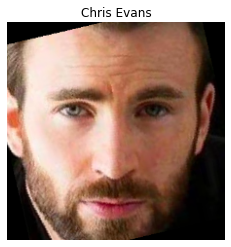

Chris Evans : 0.9951834
Chris Hemsworth : 0.002046969
Tom Hiddleston : 0.0017460457




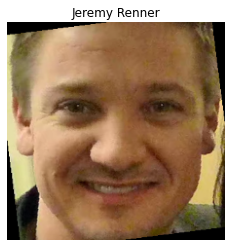

Scarlett Johansson : 0.5985994
Jeremy Renner : 0.26552314
Mark Ruffalo : 0.114402615




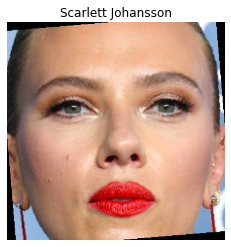

Scarlett Johansson : 0.9975019
Chris Evans : 0.0019994806
Tom Holland : 0.00015732316




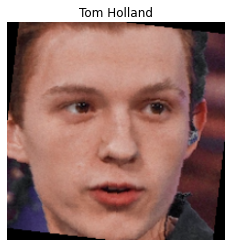

Tom Holland : 0.9991831
Jeremy Renner : 0.00040622934
Tom Hiddleston : 0.00028540374




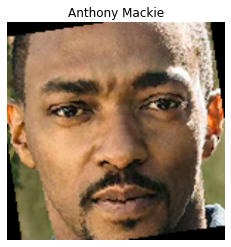

Mark Ruffalo : 0.70290834
Anthony Mackie : 0.28227493
Tom Hiddleston : 0.0123910755




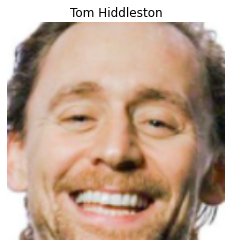

Mark Ruffalo : 0.9477993
Tom Hiddleston : 0.041143637
Robert Downey Jr : 0.004770827




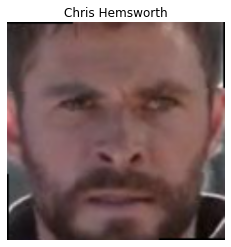

Chris Evans : 0.84274703
Tom Holland : 0.11704005
Chris Hemsworth : 0.023888666




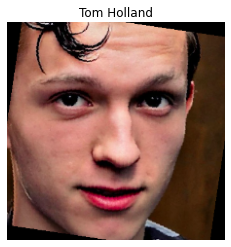

Tom Holland : 0.50907356
Scarlett Johansson : 0.4869418
Chris Evans : 0.0025189794




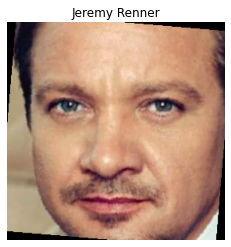

Jeremy Renner : 0.9999492
Tom Holland : 4.577581e-05
Tom Hiddleston : 2.661726e-06




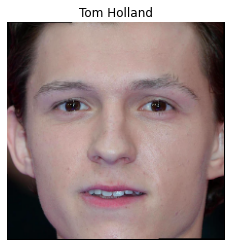

Tom Holland : 0.9866664
Scarlett Johansson : 0.0077895382
Chris Evans : 0.0045311763




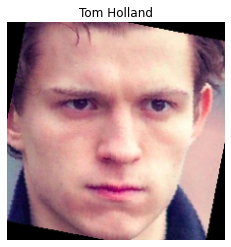

Tom Holland : 0.7977657
Jeremy Renner : 0.20085792
Chris Evans : 0.0008820331




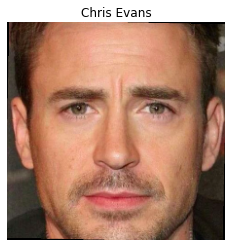

Chris Hemsworth : 0.71599853
Robert Downey Jr : 0.2277956
Mark Ruffalo : 0.046686675




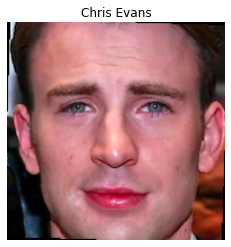

Chris Evans : 0.86715573
Jeremy Renner : 0.12196902
Tom Hiddleston : 0.0055623325




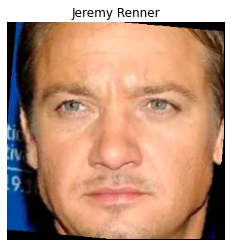

Jeremy Renner : 0.9996619
Tom Hiddleston : 0.00014562426
Scarlett Johansson : 7.388075e-05




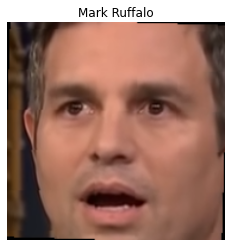

Chris Hemsworth : 0.63441265
Mark Ruffalo : 0.30099902
Tom Hiddleston : 0.045162015




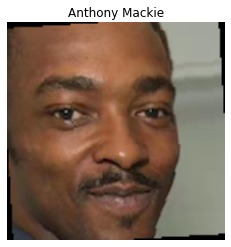

Anthony Mackie : 0.9825501
Jeremy Renner : 0.017294735
Tom Hiddleston : 6.828146e-05




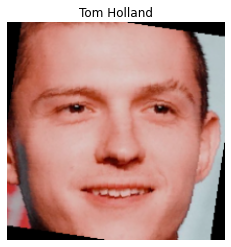

Tom Holland : 0.80145496
Tom Hiddleston : 0.1452128
Chris Evans : 0.027313007




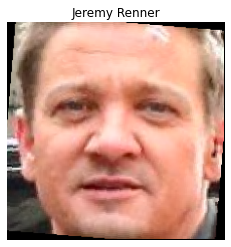

Jeremy Renner : 0.98789257
Tom Hiddleston : 0.005191549
Chris Evans : 0.0030964199




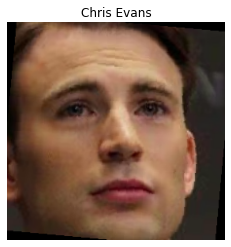

Chris Evans : 0.998495
Tom Holland : 0.0005292334
Mark Ruffalo : 0.00041993088




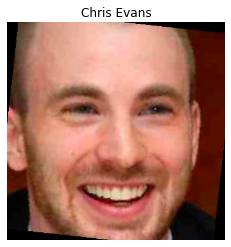

Chris Evans : 0.99236125
Tom Holland : 0.006920016
Tom Hiddleston : 0.00027560513




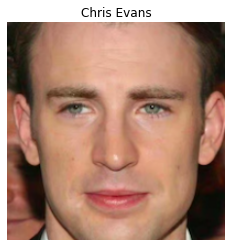

Chris Evans : 0.7498685
Tom Hiddleston : 0.21687777
Jeremy Renner : 0.026589608




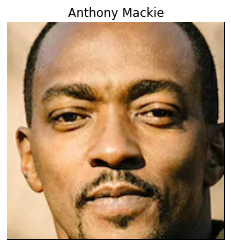

Anthony Mackie : 0.9944348
Mark Ruffalo : 0.002535466
Tom Hiddleston : 0.0017759943




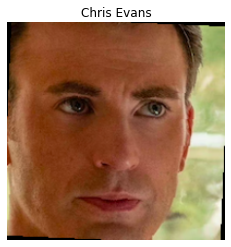

Tom Holland : 0.32812878
Mark Ruffalo : 0.20637947
Chris Evans : 0.18486916




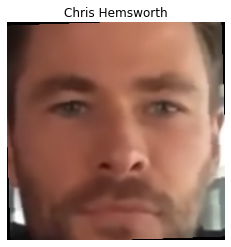

Chris Hemsworth : 0.59143835
Chris Evans : 0.23927957
Tom Hiddleston : 0.11041754




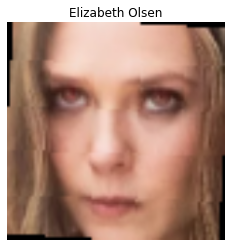

Elizabeth Olsen : 0.99673647
Chris Hemsworth : 0.0012532417
Robert Downey Jr : 0.0011252504




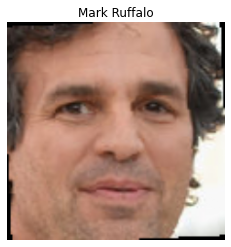

Mark Ruffalo : 0.9989955
Tom Hiddleston : 0.00046345443
Robert Downey Jr : 0.000344987




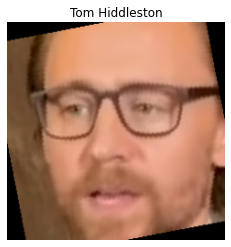

Tom Hiddleston : 0.95716625
Robert Downey Jr : 0.032074768
Mark Ruffalo : 0.009013784




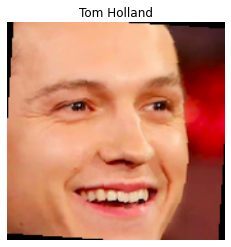

Tom Holland : 0.9902354
Elizabeth Olsen : 0.0038962779
Mark Ruffalo : 0.002065729




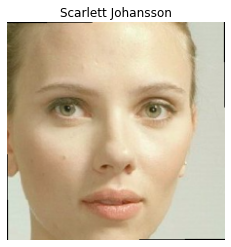

Scarlett Johansson : 0.94714934
Jeremy Renner : 0.028165903
Tom Holland : 0.009147383




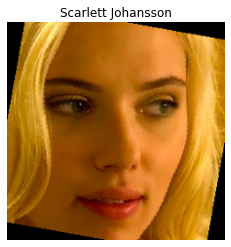

Scarlett Johansson : 0.9965064
Elizabeth Olsen : 0.003467362
Tom Holland : 1.2626613e-05




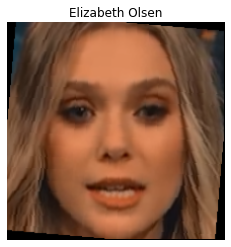

Elizabeth Olsen : 0.99954814
Scarlett Johansson : 0.0002309005
Chris Hemsworth : 0.00020342608




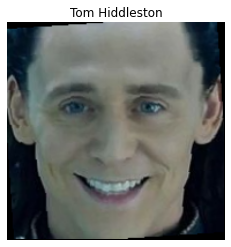

Tom Hiddleston : 0.99903655
Elizabeth Olsen : 0.00026775227
Scarlett Johansson : 0.0002039936




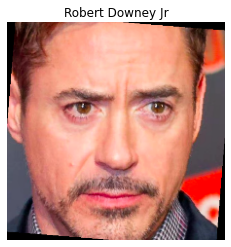

Robert Downey Jr : 0.8552043
Tom Hiddleston : 0.04749058
Chris Evans : 0.03184564




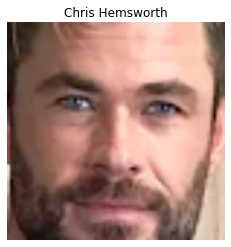

Chris Hemsworth : 0.99626946
Robert Downey Jr : 0.0037180714
Chris Evans : 1.0029246e-05




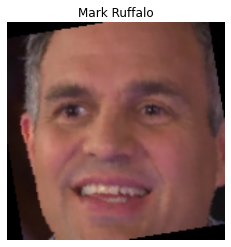

Mark Ruffalo : 0.9989549
Tom Hiddleston : 0.00090431253
Robert Downey Jr : 8.622071e-05




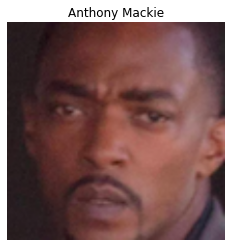

Anthony Mackie : 0.9769325
Tom Hiddleston : 0.01614327
Robert Downey Jr : 0.0034327814




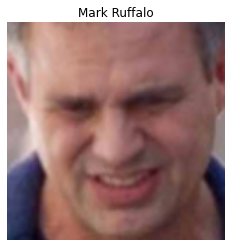

Mark Ruffalo : 0.5950671
Jeremy Renner : 0.2540047
Tom Hiddleston : 0.062029045




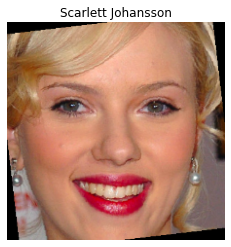

Scarlett Johansson : 0.9988801
Elizabeth Olsen : 0.0011114852
Chris Evans : 4.602847e-06


The test classification accuracy is 0.78552


In [ ]:
trained_model = classification()

if use_cuda and torch.cuda.is_available():
  trained_model.cuda()

trained_model_path = "model_{0}_bs{1}_lr{2}_epoch{3}".format(trained_model.name, 512, 0.0005, 100)
trained_model_path = weight_dir + trained_model_path
trained_model.load_state_dict(torch.load(trained_model_path))

test_accuracy = test_get_accuracy_class(trained_model, new_test_loader, new_test_label_loader, use_cuda = use_cuda)
print('The test classification accuracy is {:.5f}'.format(test_accuracy))

# Part 4: Combining Models & Demo

### Combining Everything
Now that both models are trained and tested. It is time to combine them into a complete pipeline from start to finish. The objective is to simply input a facial image and get the results without any additional user interaction required. Since the models only recognize faces and the vast majority of pictures contain some kind of background or other objects, an additional step to preprocess the input images is required. We will use a FaceNet-MTCNN face detection model that has been designed for PyTorch as part of this preprocessing step. More information can be found here: https://github.com/timesler/facenet-pytorch

In [ ]:
# Load required libraries
pip install facenet-pytorch
pip install mmcv
pip install mtcnn

from facenet_pytorch import MTCNN
from google.colab.patches import cv2_imshow
import mmcv, cv2

To keep things simple and organized, functions containing all of the necessary code to prepare model 1 and model 2 are written. In other words, running the cells below is sufficient to use the pipeline without running the cells in the above sections (assuming the weights are already trained).

In [ ]:
# Model 1
def prep_model_1(use_cuda = False):
  """
  Prepare model 1.

  In: 
  use_cuda = GPU

  Out: 
  feat_extract_1 = feature extractor (VGG16)
  model_1 = trained classifier for Model 1
  """
  # Define Classifier_1 architecture (Same as the one in Part 2)
  class Classifier_1(nn.Module):
      def __init__(self):
          super(Classifier_1, self).__init__()
          self.conv1 = nn.Conv2d(512, 50,2)
          self.conv2 = nn.Conv2d(50, 10,2)
          self.fc1 = nn.Linear(250,50)
          self.fc2 = nn.Linear(50,2)

      def forward(self, x):
          x = F.relu(self.conv1(x))
          x = F.relu(self.conv2(x))
          x = x.view(-1,250)
          x = F.relu(self.fc1(x))
          x = self.fc2(x)
          return x

  # Initiate models
  model_1 = Classifier_1()
  feat_extract_1 = torchvision.models.vgg16(pretrained = True).features # Just get the feature extraction portion

  # GPU
  if use_cuda and torch.cuda.is_available():
    feat_extract_1 = feat_extract_1.cuda()
    model_1 = model_1.cuda()

  # Get trained weights
  model_1_dir = '/content/drive/My Drive/MIE1517 Project/Saved Weight/M1/'
  model_1_weights_dir = 'vgg16model_bs32_lr0.005_epoch5'
  model_1_path = model_1_dir + model_1_weights_dir
  model_1.load_state_dict(torch.load(model_1_path))

  # Set to evaluation mode
  feat_extract_1.eval()
  model_1.eval()

  return feat_extract_1, model_1

In [ ]:
# Model 2
def prep_model_2(use_cuda = False):
  """
  Prepare model 2.

  In: 
  use_cuda = GPU

  Out: 
  resnet50 = feature extractor (ResNet50)
  model_2 = trained classifier for Model 2
  """
  # Define Classifier_2 architecture (Same as the one in Part 3)
  class Classifier_2(nn.Module):
        def __init__(self):
            super(Classifier_2, self).__init__()
            self.name = 'Classifier_2'
            self.fc1 = nn.Linear(2048*7*7, 2048)
            self.fc2 = nn.Linear(2048, 512)
            self.fc3 = nn.Linear(512, 10)

        def forward(self, x):
            x = x.view(-1, 2048*7*7)
            x = F.relu(self.fc1(x))
            x = F.relu(self.fc2(x))
            x = self.fc3(x)
            return x

  # Initiate models
  model_2 = Classifier_2()
  resnet50 = torchvision.models.resnet50(pretrained = True)
  modules = list(resnet50.children())[:-2] # Just get the feature extraction portion
  feat_extract_2 = nn.Sequential(*modules)

  # GPU
  if use_cuda and torch.cuda.is_available():
    feat_extract_2 = feat_extract_2.cuda()
    model_2 = model_2.cuda()

  # Get trained weights
  model_2_dir = '/content/drive/My Drive/MIE1517 Project/Saved Weight/M2/'
  model_2_weights_dir = 'model_classification_bs512_lr0.0005_epoch100'
  model_2_path = model_2_dir + model_2_weights_dir
  model_2.load_state_dict(torch.load(model_2_path))
  
  # Set to evaluation mode
  feat_extract_2.eval()
  model_2.eval()

  return feat_extract_2, model_2  

Next, a function that combines models 1 and 2. This is essentially the diagram shown at the beginning.

In [ ]:
def Predict(img, use_cuda = False):
  """
  Combine models 1 and 2.

  In: 
  use_cuda = GPU
  img = Facial image

  Out: 
  prediction = String either saying not an avenger cast or the name of avenger cast
  """
  # List the Avengers casts
  classes = ['Anthony Mackie', 'Chris Evans', 'Chris Hemsworth', 
           'Elizabeth Olsen', 'Jeremy Renner', 'Mark Ruffalo', 
           'Robert Downey Jr', 'Scarlett Johansson', 'Tom Hiddleston',
           'Tom Holland']

  # Ensure image is a Pytorch tensor of 224 x 224 size, and dim order is (C, H, W)
  data_transform = transforms.Compose([transforms.ToPILImage(mode = 'RGB'), transforms.ToTensor(), transforms.Resize((224, 224)) ])
  img = data_transform(img)
  img = img.unsqueeze(0) # Add batch dim to dim 0

  # GPU
  if use_cuda and torch.cuda.is_available():
    img = img.cuda()

  feat_extract_1, model_1 = prep_model_1(use_cuda) # Prepare model 1
  pred_1 = model_1(feat_extract_1(img)).max(1, keepdim=True)[1] 

  # If the model predicts the person is an Avengers cast, predict the name
  # Otherwise, output that the person is not part of the cast
  if pred_1 == 0:
    feat_extract_2, model_2 = prep_model_2(use_cuda) # Prepare model 2
    pred_2 = model_2(feat_extract_2(img))

    # Get top 3 predictions  
    prediction = []
    prob_dist = torch.softmax(pred_2.cpu().detach(), dim = 1)     # Use softmax to obtain the probabilities
    top3_prob, top3_class = torch.topk(prob_dist, 3)     # Obtain the largest 3 probabilities and the indices
    
    for idx in range(3):      
      prediction.append(classes[int(top3_class.squeeze(0)[idx])])    
    return prediction
  else:
    prediction = ["Not an Avengers cast!"]
    return prediction

Finally, the face detection preprocessing step is combined to create the entire pipeline.

In [ ]:
def Demonstration(dir, use_cuda = True):
  """
  Combining everything together.

  In: 
  use_cuda = GPU
  dir = Directory of the image to be tested

  Out: 
  The image with a bounding box of the face(s) and the prediction(s)
  """
  # Detect face
  frame = cv2.imread(dir)
  mtcnn = MTCNN(keep_all = True, device = device)
  boxes, _ = mtcnn.detect(frame)
  frame_draw = frame.copy()

  for box in boxes:
    bounding_box = []

    for i in box.tolist():
      bounding_box.append(int(i))

    frame_cropped = frame[bounding_box[1]:bounding_box[3], bounding_box[0]:bounding_box[2]]  # Crop each face
    
    # Add prediction to each cropped face
    prediction = Predict(frame_cropped, use_cuda)

    # Draw rectangle along the cropped face and add prediction label
    cv2.rectangle(frame_draw,
                  (box[0], box[1]),
                  (box[2], box[3]),
                  (0, 0, 255),
                  thickness = 2)
    
    # Add the predictions
    if len(prediction) == 1: # If the prediction is just 'Not an Avengers cast!'
      cv2.putText(frame_draw, prediction[0], (box[0], int(box[3] + 25)), 
                  cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2, cv2.LINE_AA) 
    else: # If the prediction is 3 names
      cv2.putText(frame_draw, prediction[0], (box[0], int(box[3] + 25)), 
                  cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2, cv2.LINE_AA)
      cv2.putText(frame_draw, prediction[1], (box[0], int(box[3] + 50)), 
                  cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2, cv2.LINE_AA)
      cv2.putText(frame_draw, prediction[2], (box[0], int(box[3] + 75)), 
                  cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2, cv2.LINE_AA) 
      
  cv2_imshow(frame_draw) 

### Demo

Testing on new examples that are not part of the test data.

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

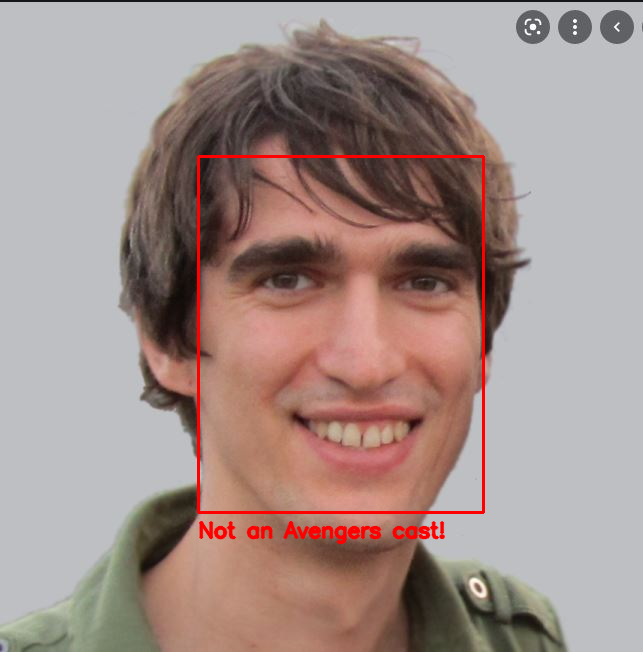

In [ ]:
dir = '/content/drive/My Drive/MIE1517 Project/Demonstration/666.jpg'
Demonstration(dir)

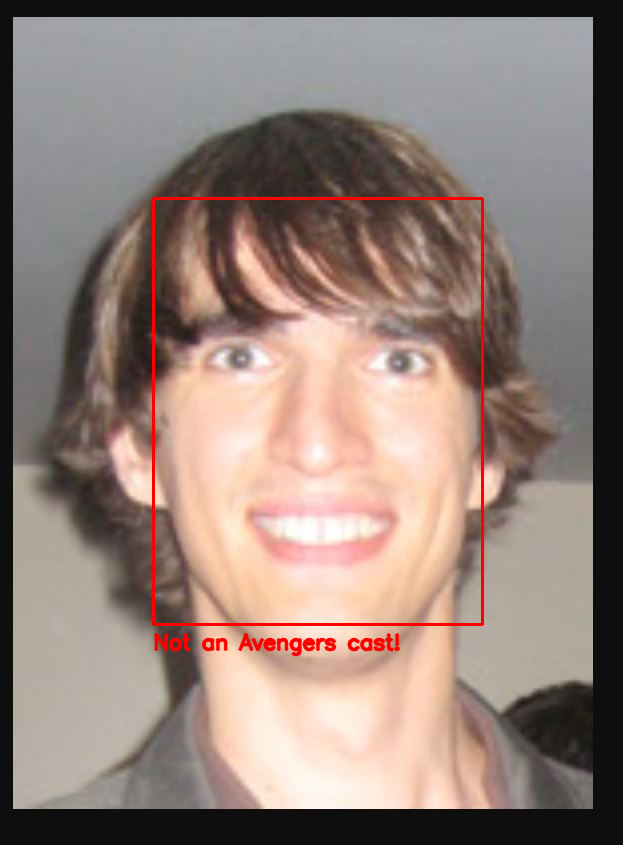

In [ ]:
dir = '/content/drive/My Drive/MIE1517 Project/Demonstration/6666.JPG'
Demonstration(dir)

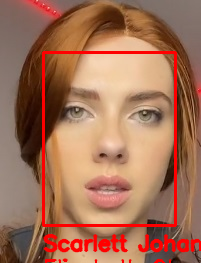

In [ ]:
dir = '/content/drive/My Drive/MIE1517 Project/Demonstration/8.jpg'
Demonstration(dir)

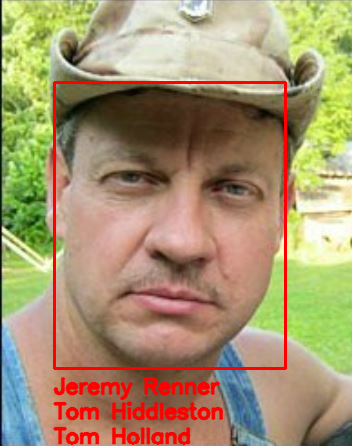

In [ ]:
dir = '/content/drive/My Drive/MIE1517 Project/Demonstration/11.jpg'
Demonstration(dir)

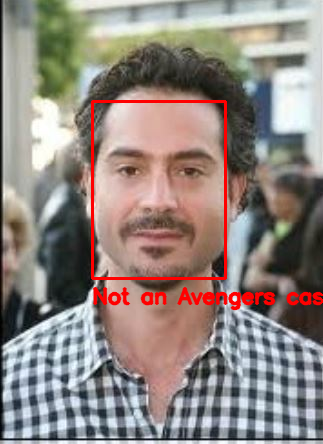

In [ ]:
dir = '/content/drive/My Drive/MIE1517 Project/Demonstration/000.JPG'
Demonstration(dir)

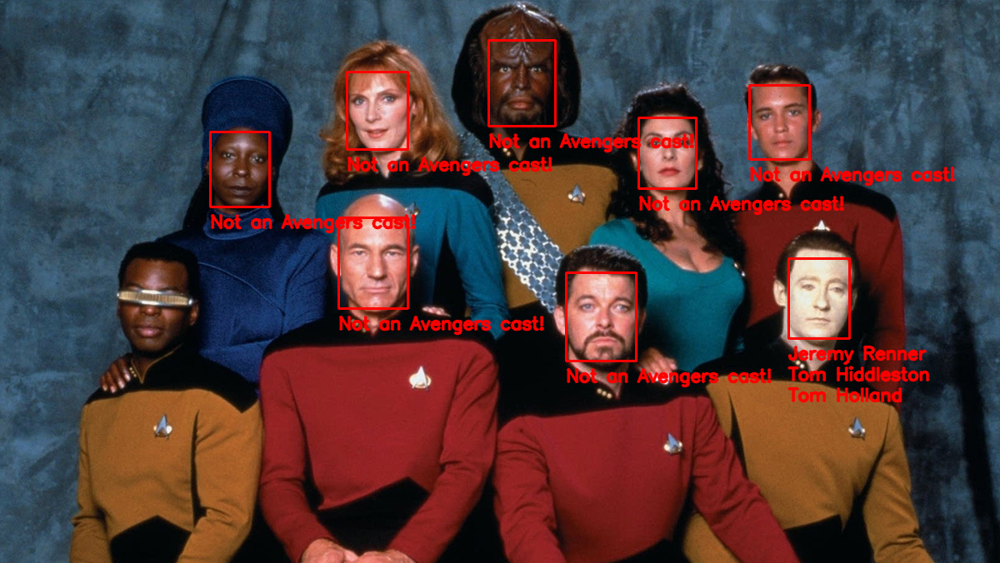

In [ ]:
dir = '/content/drive/My Drive/MIE1517 Project/Demonstration/45.jpg'
Demonstration(dir)

# Part 5: Discussions

Looking at model 1 by itself, we expected a higher accuracy because there are only 2 classes which is what we got. Some observations that we noticed are the following:
- Low quality images or faces turned to the side caused some issues 
- Scarlett Johnasson and Elizabeth Olsen's appearances frequently changed due to different hair colour and makeup. This may have caused the model to believe that they are different people, thereby occasionally predicting the wrong class

For model 2, we expected a lower accuracy than model 1 because of the large number of classes and smaller data set which is observed by the accuracies. Some specific observations that we made are the following:
- Scarlett Johnasson and Elizabeth Olsen's appearances frequently changed due to different hair colour and makeup. This caused the model to get confused between the two
- Some of the actors would keep or shave facial hair, which sometimes confused the model
- Chris Hemsworth played Thor in the Avengers Universe who had long hair, and so the model sometimes thought he was one of the actresses

Overall, the entire model pipeline worked surprisingly well, but it is clear that there are a plethora of improvements that could be made. While it was able to make accurate predictions for the most part, it would still fail on easy examples. For look-alikes, the model did not do too well (although they are challenging for humans as well).

Through working on this project, we have learned the power of transfer learning and GPU, and the importance of data quality and quantity. Without transfer learning, it is very unlikely that we would get acceptable results. Utilizing a powerful GPU saved many many hours even though Google Colab had usage limits. Lastly, our model will see greater improvements with more high quality data, which is certainly not easy to obtain most of the time. Overall, this has been a great learning experience.


# Saving to HTML

In [ ]:
%%shell
jupyter nbconvert --to html MIE1517_Project_Guide.ipynb

[NbConvertApp] Converting notebook MIE1517_Project_Guide.ipynb to html
[NbConvertApp] Writing 39814945 bytes to MIE1517_Project_Guide.html
